In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from math import acos, degrees
from scipy.signal import find_peaks
import os.path
import glob
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import entropy
import pylab as pl
from numpy.fft import fft
from scipy import stats
import numpy
from scipy import signal
from scipy.signal import lfilter, lfilter_zi, filtfilt, butter
import matplotlib.patches as mpatches
from collections import defaultdict


In [2]:
chunk_width = 900
#centr_rang = 110

In [3]:
#Function to extract angle using 3 points coordinate
def angle3pt(a, b, c):
#    """Counterclockwise angle in degrees by turning from c to a around b
#        Returns a float between 0.0 and 360.0"""
    ang = math.degrees(
    math.atan2(c[1]-b[1], c[0]-b[0]) - math.atan2(a[1]-b[1], a[0]-b[0]))
    return ang + 360 if ang < 0 else ang


In [7]:
def getridofAngleJumps(alpha):
    alpha_rad = [x*(np.pi)/180 for x in alpha]
    alpha_rad = np.array(alpha_rad)
    alpha_rad[~np.isnan(alpha_rad)] = np.unwrap(alpha_rad[~np.isnan(alpha_rad)])
    alpha_unwrap= np.degrees(alpha_rad)
    return alpha_unwrap

In [9]:
def smooth_acausal(x,frequency = 0.300):
    #b, a = signal.butter(8, 0.150)
    sos = signal.butter(4, frequency, output='sos')
    y = signal.sosfiltfilt(sos, x)
    return y


In [11]:
def smooth(x,window_len=1,window='hanning'):
#    """smooth the data using a window with requested size.

    if x.ndim != 1:
        raise ValueError("smooth only accepts 1 dimension arrays.")

    if x.size < window_len:
        raise ValueError("Input vector needs to be bigger than window size.")


    if window_len<3:
        return x


    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise ValueError("Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")


    s=np.r_[x[window_len-1:0:-1],x,x[-2:-window_len-1:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=np.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=np.convolve(w/w.sum(),s,mode='valid')
    return y


In [13]:
#Function to extract LED trajectory from excel file
def LED_excel_to_array_preprocessed(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    RidgeX = pd.read_csv(file_path[trial_no])

    #take just numeric values
    RidgeX=pd.to_numeric(RidgeX.iloc[:,0])

 
    return smooth(RidgeX.values)


In [15]:
#Function to plot tail angle trajectory
def plot_TailAngle(file_path, chunk_width, i, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])
#    df = pd.read_csv(file_path)
    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000':'tail1_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.1':'tail1_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.2':'tail1_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.3':'tail2_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.4':'tail2_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.5':'tail2_lik',                       
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.6':'tail3_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.7':'tail3_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.8':'tail3_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.9':'tail4_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.10':'tail4_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.11':'tail4_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.12':'tail5_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.13':'tail5_y',                       
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.14':'tail5_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.15':'tail6_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.16':'tail6_y',  
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.17':'tail6_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.18':'tail7_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.19':'tail7_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.20':'tail7_lik',                       
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.21':'tail8_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.22':'tail8_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.23':'tail8_lik'}, 
                 inplace=True)

    #take just numeric values
    df.tail1_x=pd.to_numeric(df.tail1_x[c-chunk_width:c+chunk_width])
    df.tail1_y=pd.to_numeric(df.tail1_y[c-chunk_width:c+chunk_width])
    df.tail1_lik=pd.to_numeric(df.tail1_lik[c-chunk_width:c+chunk_width])
    df.tail2_x=pd.to_numeric(df.tail2_x[c-chunk_width:c+chunk_width])
    df.tail2_y=pd.to_numeric(df.tail2_y[c-chunk_width:c+chunk_width])
    df.tail2_lik=pd.to_numeric(df.tail2_lik[c-chunk_width:c+chunk_width])
    df.tail3_x=pd.to_numeric(df.tail3_x[c-chunk_width:c+chunk_width])
    df.tail3_y=pd.to_numeric(df.tail3_y[c-chunk_width:c+chunk_width])
    df.tail3_lik=pd.to_numeric(df.tail3_lik[c-chunk_width:c+chunk_width])
    df.tail4_x=pd.to_numeric(df.tail4_x[c-chunk_width:c+chunk_width])
    df.tail4_y=pd.to_numeric(df.tail4_y[c-chunk_width:c+chunk_width])
    df.tail4_lik=pd.to_numeric(df.tail4_lik[c-chunk_width:c+chunk_width])
    df.tail5_x=pd.to_numeric(df.tail5_x[c-chunk_width:c+chunk_width])
    df.tail5_y=pd.to_numeric(df.tail5_y[c-chunk_width:c+chunk_width])
    df.tail5_lik=pd.to_numeric(df.tail5_lik[c-chunk_width:c+chunk_width])
    df.tail6_x=pd.to_numeric(df.tail6_x[c-chunk_width:c+chunk_width])
    df.tail6_y=pd.to_numeric(df.tail6_y[c-chunk_width:c+chunk_width])
    df.tail6_lik=pd.to_numeric(df.tail6_lik[c-chunk_width:c+chunk_width])
    df.tail7_x=pd.to_numeric(df.tail7_x[c-chunk_width:c+chunk_width])
    df.tail7_y=pd.to_numeric(df.tail7_y[c-chunk_width:c+chunk_width])
    df.tail7_lik=pd.to_numeric(df.tail7_lik[c-chunk_width:c+chunk_width])
    df.tail8_x=pd.to_numeric(df.tail8_x[c-chunk_width:c+chunk_width])
    df.tail8_y=pd.to_numeric(df.tail8_y[c-chunk_width:c+chunk_width])
    df.tail8_lik=pd.to_numeric(df.tail8_lik[c-chunk_width:c+chunk_width])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.05
    df.tail1_x.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail1_y.where((df.tail1_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_x.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail2_y.where((df.tail2_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_x.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)
    df.tail3_y.where((df.tail3_lik>lik_thresh),np.NaN,inplace=True)
    df.tail4_x.where((df.tail4_lik>lik_thresh),np.NaN,inplace=True)
    df.tail4_y.where((df.tail4_lik>lik_thresh),np.NaN,inplace=True)
    df.tail5_x.where((df.tail5_lik>lik_thresh),np.NaN,inplace=True)
    df.tail5_y.where((df.tail5_lik>lik_thresh),np.NaN,inplace=True)
    df.tail6_x.where((df.tail6_lik>lik_thresh),np.NaN,inplace=True)
    df.tail6_y.where((df.tail6_lik>lik_thresh),np.NaN,inplace=True)
    df.tail7_x.where((df.tail7_lik>lik_thresh),np.NaN,inplace=True)
    df.tail7_y.where((df.tail7_lik>lik_thresh),np.NaN,inplace=True)
    df.tail8_x.where((df.tail8_lik>lik_thresh),np.NaN,inplace=True)
    df.tail8_y.where((df.tail8_lik>lik_thresh),np.NaN,inplace=True)




    #Compute and plot tail angle in panda dataframe as last column
    angles1=[]
    angles2=[]
    angles3=[]
    angles4=[]
    angles5=[]
    angles6=[]
    angles7=[]

    for i in range(df.shape[0]):
        #x1,y1=df.tail1_x[i],df.tail1_y[i]
        vertical = np.array([df.tail1_x[i],df.tail1_y[i]+10])
        tail1 = np.array([df.tail1_x[i],df.tail1_y[i]])
        tail2 = np.array([df.tail2_x[i],df.tail2_y[i]])    
        tail3 = np.array([df.tail3_x[i],df.tail3_y[i]])
        tail4 = np.array([df.tail4_x[i],df.tail4_y[i]])
        tail5 = np.array([df.tail5_x[i],df.tail5_y[i]])    
        tail6 = np.array([df.tail6_x[i],df.tail6_y[i]])
        tail7 = np.array([df.tail7_x[i],df.tail7_y[i]])
        tail8 = np.array([df.tail8_x[i],df.tail8_y[i]])    

    #Change below to decide 3 points to determine angle
        angle1 = angle3pt(tail2, tail1, vertical)
        angle2 = angle3pt(tail3, tail1, vertical)
        angle3 = angle3pt(tail4, tail1, vertical)
        angle4 = angle3pt(tail5, tail1, vertical)
        angle5 = angle3pt(tail6, tail1, vertical)
        angle6 = angle3pt(tail7, tail1, vertical)
        angle7 = angle3pt(tail8, tail1, vertical)
        
        #Append
        angles1.append(round(angle1,2))
        angles2.append(round(angle2,2))
        angles3.append(round(angle3,2))
        angles4.append(round(angle4,2))
        angles5.append(round(angle5,2))
        angles6.append(round(angle6,2))
        angles7.append(round(angle7,2))

    df['Angles1']=angles1
    df.head()
    df['Angles2']=angles2
    df.head()
    df['Angles3']=angles3
    df.head()
    df['Angles4']=angles4
    df.head()
    df['Angles5']=angles5
    df.head()
    df['Angles6']=angles6
    df.head()
    df['Angles7']=angles7
    df.head()
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha1 = df.Angles1
    alpha2 = df.Angles2
    alpha3 = df.Angles3
    alpha4 = df.Angles4
    alpha5 = df.Angles5
    alpha6 = df.Angles6
    alpha7 = df.Angles7

    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha1 = smooth(getridofAngleJumps(alpha1))
    alpha2 = smooth(getridofAngleJumps(alpha2))
    alpha3 = smooth(getridofAngleJumps(alpha3))
    alpha4 = smooth(getridofAngleJumps(alpha4))
    alpha5 = smooth(getridofAngleJumps(alpha5))
    alpha6 = smooth(getridofAngleJumps(alpha6))
    alpha7 = smooth(getridofAngleJumps(alpha7))

    return alpha1, alpha2, alpha3, alpha4, alpha5, alpha6, alpha7

In [17]:
#Function to plot Right Paw angle trajectory
def plot_PawAngle(file_path, chunk_width, trial_no):
    #Read csv file tail markers
    df = pd.read_csv(file_path[trial_no])
#    df = pd.read_csv(file_path)

    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.24':'LP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.25':'LP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.26':'LP_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.36':'RA_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.37':'RA_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.38':'RA_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.39':'RP_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.40':'RP_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.41':'RP_lik'}, 
                 inplace=True)

    #take just numeric values
    df.RA_x=pd.to_numeric(df.RA_x[2:])
    df.RA_y=pd.to_numeric(df.RA_y[2:])
    df.RP_x=pd.to_numeric(df.RP_x[2:])
    df.RP_y=pd.to_numeric(df.RP_y[2:])
    df.LP_x=pd.to_numeric(df.LP_x[2:])
    df.LP_y=pd.to_numeric(df.LP_y[2:])
    df.RA_lik=pd.to_numeric(df.RA_lik[2:])
    df.RP_lik=pd.to_numeric(df.RP_lik[2:])
    df.LP_lik=pd.to_numeric(df.LP_lik[2:])

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.1
    df.RA_x.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.RA_y.where((df.RA_lik>lik_thresh),np.NaN,inplace=True)
    df.RP_x.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.RP_y.where((df.RP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_x.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    df.LP_y.where((df.LP_lik>lik_thresh),np.NaN,inplace=True)
    
    #extract RP x and LP x
    RP_x =  df.RP_x
    LP_x =  df.LP_x




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        vertical = np.array([df.RA_x[i],df.RA_y[i]+10])
        RA = np.array([df.RA_x[i],df.RA_y[i]])
        RP = np.array([df.RP_x[i],df.RP_y[i]])

        angle = angle3pt(RP, RA, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#    RP_x = RP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[RP_x[tot_peaks]]
#    LP_x = LP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[LP_x[tot_peaks]]

#!    return [TailAngle_traj, alpha]
    return [alpha, smooth(RP_x), smooth(LP_x)]

In [21]:
#Function to plot Right Paw angle trajectory
def plot_HipAngle(file_path, chunk_width, trial_no, c):
    #Read csv file tail markers
    df = pd.read_csv(file_path[trial_no])
#    df = pd.read_csv(file_path)

    #Rename marker columns
    df.rename(columns={'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.30':'LH_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.31':'LH_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.32':'LH_lik',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.33':'RH_x',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.34':'RH_y',
                          'DLC_resnet50_Ridge_walkMay27shuffle1_1000000.35':'RH_lik'}, 
                 inplace=True)

    #take just numeric values
    df.LH_x=pd.to_numeric(df.LH_x[c-chunk_width:c+chunk_width])
    df.LH_y=pd.to_numeric(df.LH_y[c-chunk_width:c+chunk_width])
    df.RH_x=pd.to_numeric(df.RH_x[c-chunk_width:c+chunk_width])
    df.RH_y=pd.to_numeric(df.RH_y[c-chunk_width:c+chunk_width])
    df.RH_lik=pd.to_numeric(df.RH_lik[c-chunk_width:c+chunk_width])
    df.LH_lik=pd.to_numeric(df.LH_lik[c-chunk_width:c+chunk_width])
    
    

    
    #substitute low likelihood points with NaN
    #df.tail1_x[]=np.nan
    lik_thresh = 0.1
    df.LH_x.where((df.LH_lik>lik_thresh),np.NaN,inplace=True)
    df.LH_y.where((df.LH_lik>lik_thresh),np.NaN,inplace=True)
    df.RH_x.where((df.RH_lik>lik_thresh),np.NaN,inplace=True)
    df.RH_y.where((df.RH_lik>lik_thresh),np.NaN,inplace=True)

    
    #extract RP x and LP x
    LH_x =  df.LH_x
    LH_y =  df.LH_y
    RH_x =  df.RH_x    
    RH_y =  df.RH_y




    #Compute and plot tail angle in panda dataframe as last column
    angles=[]
    for i in range(df.shape[0]):
        vertical = np.array([df.RH_x[i],df.RH_y[i]+10])
        RH = np.array([df.RH_x[i],df.RH_y[i]])
        LH = np.array([df.LH_x[i],df.LH_y[i]])

        angle = angle3pt(LH, RH, vertical)
        #Append
        angles.append(round(angle,2))
    df['Angles']=angles
    df.head()
    
    #Create a list comprehension by chunking x (centroid X trajectory) in 'chunk_width' frames and alpha (tail angle traj)
    #x = CentroidXY.X
    alpha = df.Angles
    #Get alpha value at perturbation time to centre the trace to that value
#    alpha_centred = alpha[tot_peaks]
    #Apply function to get rid of angle jumps
    alpha = getridofAngleJumps(alpha)
    #Apply function to smooth
    alpha = smooth(alpha)
#    TailAngle_traj = alpha[tot_peaks-chunk_width:tot_peaks+chunk_width]-[alpha[tot_peaks]-alpha_centred]# for i in tot_peaks]
#    RP_x = RP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[RP_x[tot_peaks]]
#    LP_x = LP_x[tot_peaks-chunk_width:tot_peaks+chunk_width]-[LP_x[tot_peaks]]

#!    return [TailAngle_traj, alpha]
    return alpha

In [23]:
# #Function to extract centroid X Y trajectory
# def extract_Centroid(file_path, chunk_width, trial_no):
#     #Read csv file tail markers
#     CentroidXY = pd.read_csv(file_path[trial_no])

#     CentroidXY.rename(columns={'NaN':'X',
#                               'NaN.1':'Y'}, 
#                      inplace=True)
#     #take just numeric values
#     CentroidXY.Centroid_x=pd.to_numeric(CentroidXY.X)
#     CentroidXY.Centroid_y=pd.to_numeric(CentroidXY.Y)

#     #extract Centroid x and y
#     CentroidX =  CentroidXY.Centroid_x.values
#     CentroidY =  CentroidXY.Centroid_y.values
#     CentroidX = [el for el in CentroidX]
#     CentroidY = [el for el in CentroidY]

#     return np.array(CentroidX).ravel(), np.array(CentroidY).ravel()


In [25]:
#Function to extract centroid X Y trajectory (generalized for cases where first value is not NaN)

def extract_Centroid(file_path, chunk_width, trial_no):
    # Read csv file tail markers
    CentroidXY = pd.read_csv(file_path[trial_no])

    # Extract the first two columns, assuming they represent X and Y values
    CentroidXY = CentroidXY.iloc[:, :2]

    # Rename columns to 'X' and 'Y'
    CentroidXY.columns = ['X', 'Y']

    # Take just numeric values
    CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
    CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')

    # Extract Centroid x and y
    CentroidX = CentroidXY.Centroid_x.values
    CentroidY = CentroidXY.Centroid_y.values

    return np.array(CentroidX).ravel(), np.array(CentroidY).ravel()


In [27]:
#Function to extract BoS area (generalized for cases where first value is not NaN)

def extract_BoS(file_path, chunk_width, trial_no):
    # Read csv file tail markers
    CentroidXY = pd.read_csv(file_path[trial_no])

    # Extract the first two columns, assuming they represent X and Y values
    CentroidXY = CentroidXY.iloc[:, :2]

    # Rename columns to 'X' and 'Y'
    CentroidXY.columns = ['BoS']

    # Take just numeric values
    CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')

    # Extract Centroid x and y
    CentroidX = CentroidXY.Centroid_x.values

    return np.array(CentroidX).ravel()

In [29]:
#Function to extract BoS area (generalized for cases where first value is not NaN)

def extract_BodyAxis(file_path, chunk_width, trial_no):
    # Read csv file tail markers
    CentroidXY = pd.read_csv(file_path[trial_no])

    # Extract the first two columns, assuming they represent X and Y values
    CentroidXY = CentroidXY.iloc[:, :2]

    # Rename columns to 'X' and 'Y'
    CentroidXY.columns = ['BodyAxis']

    # Take just numeric values
    CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')

    # Extract Centroid x and y
    CentroidX = CentroidXY.Centroid_x.values

    return np.array(CentroidX).ravel()

In [31]:
def find_delay(a, b):
    corr_a_b = np.correlate(a-np.mean(a), b-np.mean(b), mode = 'full')
    delay = np.where(corr_a_b == numpy.amin(corr_a_b))# -(np.size(corr_a_b)+1)/2
    return delay[0]-(np.size(corr_a_b)+1)/2

In [33]:
#Function to plot Right Paw angle trajectory
def plot_Centroid_edge_dist(file_path, chunk_width, i):
    #Read csv file tail markers
    df = pd.read_csv(file_path[i])

##Open Centroid file from top camera
#CentroidXY = pd.read_csv('C:/Users/Salvo/Desktop/Ridge/DLC_videos/Videos_to_analyzeDLC/Ridge_MiceS20-S24_16thApril/perturbation_8mm_1/8_S22/Centroid.csv')

    #Select 1st column csv file
    matrix2 = df[df.columns[0]]#.as_matrix()
    Centroid1stcol = matrix2.tolist() #file 1st column


#    CentroidXY.rename(columns={'NaN':'dist'}, 
#                     inplace=True)
    #take just numeric values
    Centroid1stcol = pd.to_numeric(Centroid1stcol)
#    CentroidXY.Centroid_y=pd.to_numeric(CentroidXY.Y)

    #extract Centroid x and y
#    CentroidX =  CentroidXY.Centroid_x
#    CentroidY =  CentroidXY.Centroid_y
    
#    Centroid_list = CentroidX[tot_peaks-chunk_width:tot_peaks+centr_rang-chunk_width]#-[CentroidX[tot_peaks]]
    
#    Centroid_list = CentroidX[tot_peaks-chunk_width-100:tot_peaks-100]-[CentroidX[tot_peaks-100]]
    return smooth(Centroid1stcol)

In [36]:
#np.arange(len(file_to_open)-25)


In [39]:

def firstNonNan(listfloats):
    i = 0
    for item in listfloats:
        i += 1
        if math.isnan(item) == False:
            return i

#firstNonNan(t)

In [42]:
def HIST_MI_2_var(a, b):
    fig = plt.figure(figsize=(10,14))
    ax1 = plt.subplot(311)
    ax2 = plt.subplot(312)
    hist_centr = ax1.hist(a, density=True, bins=30, color = 'orange')  # `density=False` would make counts
    hist_tail = ax2.hist(b, density=True, bins=30, color = 'blue')  # `density=False` would make counts
#    ent_cent = entropy(hist_centr[0], base=2)
#    ent_tail = entropy(hist_tail[0], base=2)
    MI_cent_tail = metrics.mutual_info_score(hist_centr[0], hist_tail[0])
    return MI_cent_tail

In [45]:
def get_delay_array(var1, var2):
    var1 = var1[~np.isnan(var1)] #centroid
    var2 = var2[~np.isnan(var2)] #TA
    #take the mean out
#    var1 = var1-np.mean(var1)
#    var2 = var2-np.mean(var2)

    corr_a_b = np.correlate(var2, var1, mode = 'full')
    norm_corr_a_b = np.correlate(var2/np.std(var2), var1/np.std(var1), mode = 'full')
    cc_trace_midpoint = len(norm_corr_a_b)
    delay = np.argmax(abs(norm_corr_a_b))-(cc_trace_midpoint/2)+1 #Get the delay of the absolute max peak
    max_peak = max(norm_corr_a_b, key=abs)
#    max_peak = abs(max(corr_a_b, key=abs))
    return delay, max_peak

In [49]:
def get_fft(chunk_width, data):
    # Number of sample points
    N = chunk_width*2
    # sample spacing
    T = 1/300
    x = np.linspace(0.0, N*T, N)
    y = data
    yf = fft(y)
    xf = np.linspace(0, 1/(2*T), N//2)
#    plt.plot(xf, 2/N * np.abs(yf[0:N//2]))
#    plt.grid()
#    plt.show()
    return xf, yf

In [51]:
def findpeaks_extractchunk(x_diff, x, y, z, w, t, threshold_height, chunk_width_step):
    peaks, _ = find_peaks(x_diff, height=threshold_height)
    out_step = []
    out_TA = []
    out_HA = []
    out_cent = []
    out_RstepAng = []

    for i in np.arange(len(peaks)):
        chunk_trial_step = x[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_TA = y[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_HA = z[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_cent = w[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        chunk_trial_RstepAng = t[peaks[i]-chunk_width_step:peaks[i]+chunk_width_step]
        

        out_step.append(chunk_trial_step)
        out_TA.append(chunk_trial_TA)
        out_HA.append(chunk_trial_HA)
        out_cent.append(chunk_trial_cent)
        #transpose all traces of step angle greater than 360 back to 0
        if np.nanmean(chunk_trial_RstepAng) > 250:
            out_RstepAng.append(chunk_trial_RstepAng-360)
        elif np.nanmean(chunk_trial_RstepAng) < -150:
            out_RstepAng.append(chunk_trial_RstepAng+360)   
        else:
            out_RstepAng.append(chunk_trial_RstepAng)


    
    return out_step, out_TA, out_HA, out_cent, out_RstepAng

In [53]:
import matplotlib.pyplot as plt
import matplotlib.text as mpl_text

class AnyObject(object):
    def __init__(self, text, color):
        self.my_text = text
        self.my_color = color

class AnyObjectHandler(object):
    def legend_artist(self, legend, orig_handle, fontsize, handlebox):
        print(orig_handle)
        x0, y0 = handlebox.xdescent, handlebox.ydescent
        width, height = handlebox.width, handlebox.height
        patch = mpl_text.Text(x=0, y=0, text=orig_handle.my_text, color=orig_handle.my_color, verticalalignment=u'baseline', 
                                horizontalalignment=u'left', multialignment=None, 
                                fontproperties=None, rotation=45, linespacing=None, 
                                rotation_mode=None)
        handlebox.add_artist(patch)
        return patch

In [55]:
def delete_bad_traces_FromList(Traces_List, idx_to_eliminate):
    for l in np.arange(len(idx_to_eliminate)):
        for i in np.arange(len(Traces_List)):
            for j in np.arange(len(Traces_List[i])):
                if len(Traces_List[i][j]) == 200:
                    if i == idx_to_eliminate[l][0] and j == idx_to_eliminate[l][1]:
                        Traces_List[i][j] = [] 
    return Traces_List

In [57]:
# def check_trace(trace):
#     if np.nanmean(trace) <-50:
#         trace = trace + 360
# #    if np.nanmean(trace) >400:
# #        trace = trace - 360
#     return trace

In [59]:
# def check_trace_within_0_to_150(trace):
#     if np.nanmean(trace) <-50:
#         trace = trace + 360
#         if np.nanmean(trace) <-50:
#             trace = trace + 360
# #    elif np.nanmean(trace[0:60]) >150:
# #        trace = []
#     else:
#         trace = trace
#     return trace

In [62]:
def pad_sequences(sequences):
    """
    Pad sequences with NaN values to make them equal in length.
    
    Args:
    sequences (list of arrays): List of sequences to be padded.
    
    Returns:
    numpy.ndarray: An array containing the padded sequences.
    """
    # Find the maximum length among all sequences
    max_length = max(len(seq) for seq in sequences)
    
    # Pad the sequences with NaN values to make them equal in length
    padded_sequences = []
    for seq in sequences:
        padded_seq = np.pad(seq, (0, max_length - len(seq)), mode='constant', constant_values=np.nan)
        padded_sequences.append(padded_seq)
    
    # Convert the list of padded sequences to a numpy array
    padded_sequences = np.array(padded_sequences)
    
    return padded_sequences


In [64]:
def fill_nan(arr):
#     mask = np.isnan(arr)
#     idx = np.where(~mask,np.arange(mask.size),0)
#     np.maximum.accumulate(idx, out=idx)
#     arr[mask] = arr[idx]
    df = pd.DataFrame(data=arr.flatten())
    df = df.fillna(value=None, method='backfill', axis=None, limit=70, downcast=None)
    arr = df.values
#    print(type(arr))
    return arr.ravel()

In [68]:
def get_folders_with_suffix(folder_path, suffix, exclude_folders=[]):
    folder_names = []
    # Check if the folder path exists
    if os.path.exists(folder_path):
        # Iterate through all items (files and folders) in the specified path
        for item in os.listdir(folder_path):
            # Join the current item with the folder path to get its full path
            item_path = os.path.join(folder_path, item)
            # Check if the item is a directory and its name ends with the specified suffix
            if os.path.isdir(item_path) and item.endswith(suffix):
                # Check if the folder should be excluded
                if item not in exclude_folders:
                    # If it meets the conditions and is not excluded, append its name to the folder_names list
                    folder_names.append(item)
    else:
        print("Folder path does not exist!")
    return folder_names


folder_path = "E://Ridge_opto_M251_264_July2023"
suffix = "2023"
exclude_folders = ["analysis_scripts_opto_July2023", 'ORE_M251-64_Tilt_L_4mm_06July2023', 'ORE_M251-64_Tilt_L_4mm_10July2023',\
                  'ORE_M251-64_Tilt_R_4mm_07July2023', 'ORE_M251-64_Tilt_R_4mm_11July2023']#'12April2024', 
folders_with_suffix = get_folders_with_suffix(folder_path, suffix, exclude_folders)
print(folders_with_suffix)

['ORE_M251-64_StimON_L_10mm_24July2023', 'ORE_M251-64_StimON_L_45mm_22July2023', 'ORE_M251-64_StimON_L_4mm_12July2023', 'ORE_M251-64_StimON_L_4mm_27July2023', 'ORE_M251-64_StimON_R_10mm_25July2023', 'ORE_M251-64_StimON_R_45mm_23July2023', 'ORE_M251-64_StimON_R_4mm_13July2023', 'ORE_M251-64_StimON_R_4mm_28July2023']


In [70]:
folders_with_suffix

['ORE_M251-64_StimON_L_10mm_24July2023',
 'ORE_M251-64_StimON_L_45mm_22July2023',
 'ORE_M251-64_StimON_L_4mm_12July2023',
 'ORE_M251-64_StimON_L_4mm_27July2023',
 'ORE_M251-64_StimON_R_10mm_25July2023',
 'ORE_M251-64_StimON_R_45mm_23July2023',
 'ORE_M251-64_StimON_R_4mm_13July2023',
 'ORE_M251-64_StimON_R_4mm_28July2023']

C:\Users\salva\AppData\Local\Temp\ipykernel_113828\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\salva\AppData\Local\Temp\ipykernel_113828\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\salva\AppData\Local\Temp\ipykernel_113828\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\salva\AppData\Local\Temp\ipykernel_113828\3846220271.py:14: UserWarning: Pandas 

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas does

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_y = pd.to_numeric(CentroidXY.Y, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\2494085095.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BoS, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3846220271.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.BodyAxis, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:14: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  CentroidXY.Centroid_x = pd.to_numeric(CentroidXY.X, errors='coerce')
C:\Users\Salvo\AppData\Local\Temp\ipykernel_19436\3873563067.py:15: UserWarning: Pand

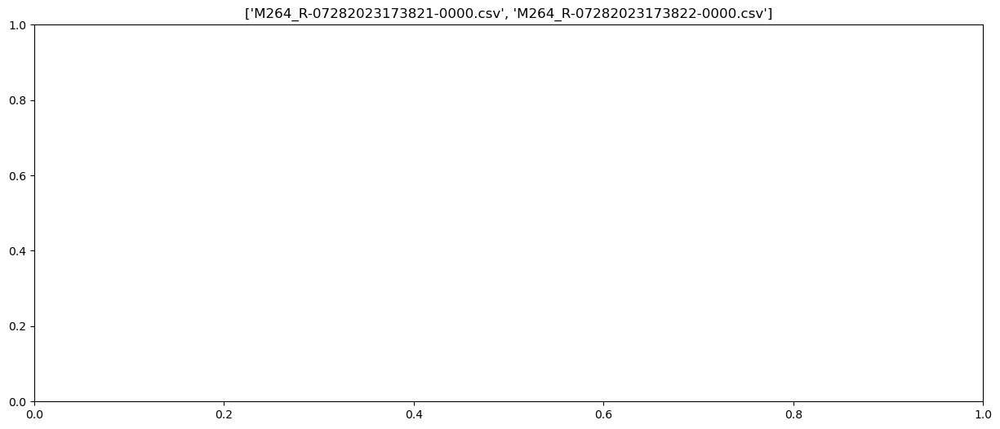

In [ ]:
### Organize all data into python dict

# search_key_path = ['*L_4mm_12July2023*', '*R_4mm_13July2023*', '*L_4mm_27July2023*', '*R_4mm_28July2023*', \
#                    '*L_10mm_24July2023*', '*R_10mm_25July2023*', '*L_45mm_22July2023*', '*R_45mm_23July2023*']
# search_key = ['L_4mm_12July2023', 'R_4mm_13July2023', 'L_4mm_27July2023', 'R_4mm_28July2023', \
#               'L_10mm_24July2023', 'R_10mm_25July2023', 'L_45mm_22July2023', 'R_45mm_23July2023']
clrs = sns.color_palette("viridis", n_colors=8)  

search_key_path = folders_with_suffix
search_key = folders_with_suffix


dict_ridge_widths = defaultdict(dict)
dict_ridge_all = defaultdict(dict)
fig, ax1 = plt.subplots(1, 1, figsize=(15,6))

for j in np.arange(len(search_key_path)):
    data_location = "E://Ridge_opto_M251_264_July2023"
    LED_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'LED_track//*.csv'))
#     TA_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'side_cam//*//*.csv'))
    Centroid_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'Centroid_XY//*.csv'))
    BoS_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'BoS//*.csv'))
    BodyAxis_ExcelList_to_open = glob.glob(os.path.join(os.path.sep, data_location, search_key_path[j], 'BodyAxis//*.csv'))

#   Sort files based on filenames
    # Sort the file list based on filename
    LED_ExcelList_to_open = sorted(LED_ExcelList_to_open, key=lambda x: os.path.basename(x))
    Centroid_ExcelList_to_open = sorted(Centroid_ExcelList_to_open, key=lambda x: os.path.basename(x))
    BoS_ExcelList_to_open = sorted(BoS_ExcelList_to_open, key=lambda x: os.path.basename(x))
    BodyAxis_ExcelList_to_open = sorted(BodyAxis_ExcelList_to_open, key=lambda x: os.path.basename(x))
    
    for i in np.arange(len(LED_ExcelList_to_open)): # len(peaks)
        #Extract arrays
        LED_traj = LED_excel_to_array_preprocessed(LED_ExcelList_to_open, chunk_width, i)
        CentroidX_traj, CentroidY_traj = extract_Centroid(Centroid_ExcelList_to_open, chunk_width, i)
        BoS_traj = extract_BoS(BoS_ExcelList_to_open, chunk_width, i)
        BodyAxis_traj = extract_BodyAxis(BodyAxis_ExcelList_to_open, chunk_width, i)

        #Extract traces of Centroid and Tail Angle around the time frame when the mouse is at the ridge center
        a = firstNonNan(CentroidX_traj)
        b = round((np.size(CentroidX_traj) - np.count_nonzero(np.isnan(CentroidX_traj)))/2)
        c = a + b

        #Take tail angle traj after extracting chunk of traj of interest around c
#         print(TA_ExcelList_to_open[i])
#         TA1, TA2, TA3, TA4, TA5, TA6, TA7 = plot_TailAngle(TA_ExcelList_to_open, chunk_width, i, c)        
#         HipAngle_traj = plot_HipAngle(TA_ExcelList_to_open, chunk_width, i, c)
#         pawangle, RPaw_traj, LPaw_traj = plot_PawAngle(TA_ExcelList_to_open, chunk_width, i)

#         TA1_chunk = fill_nan(TA1[c-chunk_width:c+chunk_width])
#         TA2_chunk = fill_nan(TA2[c-chunk_width:c+chunk_width])
#         TA3_chunk = fill_nan(TA3[c-chunk_width:c+chunk_width])
#         TA4_chunk = fill_nan(TA4[c-chunk_width:c+chunk_width])
#         TA5_chunk = fill_nan(TA5[c-chunk_width:c+chunk_width])
#         TA6_chunk = fill_nan(TA6[c-chunk_width:c+chunk_width])
#         TA7_chunk = fill_nan(TA7[c-chunk_width:c+chunk_width])

#         HipAngle_traj_chunk = fill_nan(HipAngle_traj[c-chunk_width:c+chunk_width])
#         RPaw_traj_traj_chunk = RPaw_traj[c-chunk_width:c+chunk_width]
#         LPaw_traj_traj_chunk = LPaw_traj[c-chunk_width:c+chunk_width]
# #         BodyAxis_traj_chunk = fill_nan(BodyAxis_traj[c-chunk_width:c+chunk_width])

#         CentroidX_traj_chunk = fill_nan(CentroidX_traj[c-chunk_width:c+chunk_width])
#         CentroidY_traj_chunk = fill_nan(CentroidY_traj[c-chunk_width:c+chunk_width])
        CentroidX_chunk  = fill_nan(CentroidX_traj[c-chunk_width:c+chunk_width])
        CentroidY_chunk  = fill_nan(CentroidY_traj[c-chunk_width:c+chunk_width])
        LED_traj_chunk = fill_nan(LED_traj[c-chunk_width:c+chunk_width])
        BoS_traj_chunk = fill_nan(BoS_traj[c-chunk_width:c+chunk_width])
        BodyAxis_traj_chunk = fill_nan(BodyAxis_traj[c-chunk_width:c+chunk_width])

        
        #Decide here what variables to plot in the three figures
        var1 = np.array(LED_traj_chunk)
        var2 = np.array(BoS_traj_chunk)
        var3 = np.array(CentroidX_chunk)
        var4 = np.array(CentroidY_chunk)
        var5 = np.array(BodyAxis_traj_chunk)

#         print(len(RPaw_traj_traj_chunk), len(LPaw_traj_traj_chunk), len(HipAngle_traj_chunk), len(HipAngle_traj_chunk),\
#              len(CentroidY_traj_chunk), len(CentroidX_traj_chunk), len(TA1_chunk), len(TA2_chunk))
#         # List of sequences to be padded
#         sequences = [RPaw_traj_traj_chunk, LPaw_traj_traj_chunk, HipAngle_traj_chunk, HipAngle_traj_chunk,
#                      CentroidY_traj_chunk, CentroidX_traj_chunk, TA1_chunk, TA2_chunk, TA3_chunk, TA4_chunk,
#                      TA5_chunk, TA6_chunk, TA7_chunk]

#         # Pad the sequences
#         var4 = pad_sequences(sequences)
#         var5 = CentroidX_traj_chunk
# #        Plot traces
#         fig, ax1 = plt.subplots(1, 1, figsize=(15,6))
#         ax1.plot(LED_traj_chunk, 'r')
# #         ax1.plot(TA1)#TA1_chunk
#         ax1.plot(BoS_traj_chunk)#TA1_chunk

        key_file_name_LED = os.path.basename(LED_ExcelList_to_open[i])
#         key_file_name_TA = os.path.basename(TA_ExcelList_to_open[i])
        key_file_name_CentXY = os.path.basename(Centroid_ExcelList_to_open[i])

        ax1.set_title([key_file_name_LED, key_file_name_CentXY])

        #Make dict
        dict_ridge_widths[search_key[j]][key_file_name_LED] = [var1, var2, var3, var4, var5]

        dict_ridge_all['all'][key_file_name_LED] = [var1, var2, var3, var4, var5]

In [70]:
import pickle

# Saving the dictionary
with open('dictionary_optoVCJulyBoS.pkl', 'wb') as f:
    pickle.dump(dict_ridge_widths, f)

# Loading the dictionary
with open('dictionary_optoVCJulyBoS.pkl', 'rb') as f:
    loaded_dict = pickle.load(f)
dict_ridge_widths = loaded_dict

NameError: name 'dict_ridge_widths' is not defined

In [73]:
beg_inter_PSTH = 50
end_inter_PSTH = 200

In [75]:
def find_peak_onset(arr, jump_threshold):
    # Find the first index where the difference between consecutive elements exceeds the jump threshold
    for i in range(1, len(arr)):
        if arr[i] - arr[i-1] > jump_threshold:
            return i
    # If no peak onset is found, return None
    return None


In [78]:
def assign_dict_value_LEDPeak(dict_ridge):
    #Find ridge peak for pert trials (-1, 1 values) and append to 7th column
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys())

    for i in np.arange(len(key_list)):
        LEDTraj = values_list[i][0]
        #Choose a threshold value to detect (for now 1000)
        ridge_tilt_peak_idx = find_peak_onset(LEDTraj, 100)
    
        if ridge_tilt_peak_idx:
            #Use this for PSTH centered at beg of tilt
            dict_ridge[key_list[i]].append(ridge_tilt_peak_idx)    
        else:
            print('Deleted trial because no LED detected', key_list[i], (LEDTraj))
#             plt.plot(LEDTraj)
            #eliminate trials without LED change detected
            key_to_be_deleted = key_list[i]
            dict_ridge.pop(key_to_be_deleted, None)            

    return dict_ridge

In [82]:
def assign_dict_value_TA_and_Ridge_chunkPSTH(dict_ridge):
    # Take pert trials (9th col) and based on peak (7th col) extract chunk of flipped Ridge and TA traj (6th and 10th col) 
    # Assign those traces to col 11 and 12
    
    values_list = list(dict_ridge.values())
    key_list = list(dict_ridge.keys())
    fig, ax1 = plt.subplots(1, 1, figsize=(15,6))
    for i in np.arange(len(key_list)):
#         fig, ax1 = plt.subplots(1, 1, figsize=(15,6))
        
#         HA_trace = values_list[i][3][2]
        BoS_trace = values_list[i][1]
        LED_peak = values_list[i][-1]
        LED_trace = values_list[i][0]
        CentX_trace = values_list[i][2]
        CentY_trace = values_list[i][3]
        BodyAxis_trace = values_list[i][4]


        BoS_chunk = BoS_trace[LED_peak-beg_inter_PSTH:LED_peak+end_inter_PSTH]
        LED_chunk = LED_trace[LED_peak-beg_inter_PSTH:LED_peak+end_inter_PSTH]
        CentX_chunk = CentX_trace[LED_peak-beg_inter_PSTH:LED_peak+end_inter_PSTH]
        CentY_chunk = CentY_trace[LED_peak-beg_inter_PSTH:LED_peak+end_inter_PSTH]
        BodyAxis_chunk = BodyAxis_trace[LED_peak-beg_inter_PSTH:LED_peak+end_inter_PSTH]

        
        plt.plot(BodyAxis_chunk)
#         plt.plot((LED_trace)-LED_trace[0])
#         plt.plot(LED_peak, LED_trace[LED_peak], 'x')
#         plt.ylim(-50,380)
        plt.title("{i}".format(i = key_list[i]))

        dict_ridge[key_list[i]].append([BoS_chunk, LED_chunk, LED_peak, CentX_chunk, CentY_chunk, BodyAxis_chunk])

 


    return dict_ridge

In [88]:
def get_folders_with_suffix(folder_path, suffix, exclude_folders=[]):
    folder_names = []
    # Check if the folder path exists
    if os.path.exists(folder_path):
        # Iterate through all items (files and folders) in the specified path
        for item in os.listdir(folder_path):
            # Join the current item with the folder path to get its full path
            item_path = os.path.join(folder_path, item)
            # Check if the item is a directory and its name ends with the specified suffix
            if os.path.isdir(item_path) and item.endswith(suffix):
                # Check if the folder should be excluded
                if item not in exclude_folders:
                    # If it meets the conditions and is not excluded, append its name to the folder_names list
                    folder_names.append(item)
    else:
        print("Folder path does not exist!")
    return folder_names


folder_path = "E://Ridge_opto_M251_264_July2023"
suffix = "2023"
exclude_folders = ["analysis_scripts_opto_July2023", 'ORE_M251-64_Tilt_L_4mm_06July2023', 'ORE_M251-64_Tilt_L_4mm_10July2023',\
                  'ORE_M251-64_Tilt_R_4mm_07July2023', 'ORE_M251-64_Tilt_R_4mm_11July2023', \
                  'ORE_M251-64_StimON_L_10mm_24July2023', 'ORE_M251-64_StimON_R_10mm_25July2023', \
                  'ORE_M251-64_StimON_L_4mm_27July2023', 'ORE_M251-64_StimON_R_4mm_28July2023']#'12April2024', '22March2024', '15April2024', '16April2024', '17April2024', '18April2024', '19April2024']
folders_with_suffix = get_folders_with_suffix(folder_path, suffix, exclude_folders)
print(folders_with_suffix)

['ORE_M251-64_StimON_L_45mm_22July2023', 'ORE_M251-64_StimON_L_4mm_12July2023', 'ORE_M251-64_StimON_R_45mm_23July2023', 'ORE_M251-64_StimON_R_4mm_13July2023']


In [92]:
outliers_key = ['M251_L-07122023095216-0000.csv', 'M251_L-07122023095518-0000.csv', 'M253_L-07122023102117-0000.csv',
               'M253_L-07122023102146-0000.csv',
'M253_L-07122023102231-0000.csv',
'M253_L-07122023102326-0000.csv',
'M253_L-07122023102414-0000.csv',
'M256_L-07122023131640-0000.csv',
'M256_L-07122023131927-0000.csv',
'M259_L-07122023154212-0000.csv',
'M259_L-07122023154506-0000.csv',
'M260_L-07122023155929-0000.csv',
'M251_L-07122023095943-0000.csv',
'M251_L-07122023100339-0000.csv',
'M253_L-07122023103052-0000.csv',
'M253_L-07122023103222-0000.csv',
'M256_L-07122023131958-0000.csv',
'M256_L-07122023132459-0000.csv',
'M256_L-07122023132649-0000.csv',
'M256_L-07122023133032-0000.csv',
'M256_L-07122023133201-0000.csv',
'M256_L-07122023133233-0000.csv',
'M256_L-07122023133417-0000.csv',
'M256_L-07122023133509-0000.csv',
'M256_L-07122023133537-0000.csv',
'M259_L-07122023155055-0000.csv',
'M259_L-07122023155136-0000.csv',
'M260_L-07122023160024-0000.csv',
'M260_L-07122023160042-0000.csv',
'M260_L-07122023160126-0000.csv',
'M260_L-07122023160200-0000.csv',
'M260_L-07122023160218-0000.csv',
'M260_L-07122023160420-0000.csv',
'M261_L-07122023162237-0000.csv',
'M261_L-07122023162417-0000.csv',
'M261_L-07122023162435-0000.csv',
'M261_L-07122023162522-0000.csv',
'M261_L-07122023162736-0000.csv',
'M261_L-07122023162753-0000.csv',
'M261_L-07122023162846-0000.csv',
'M261_L-07122023163038-0000.csv',
'M261_L-07122023163200-0000.csv',
'M262_L-07122023164023-0000.csv',
'M262_L-07122023164057-0000.csv',
'M262_L-07122023164133-0000.csv',
'M262_L-07122023164226-0000.csv',
'M262_L-07122023164405-0000.csv',
'M262_L-07122023164537-0000.csv',
'M251_L-07122023095630-0000.csv',
'M251_L-07122023100009-0000.csv',
'M251_L-07122023100131-0000.csv',
'M251_L-07122023100403-0000.csv',
'M259_L-07122023153815-0000.csv',
'M259_L-07122023155114-0000.csv',
'M260_L-07122023155810-0000.csv',
'M260_L-07122023160310-0000.csv',
'M260_L-07122023160345-0000.csv'
'M260_L-07122023160438-0000.csv',
'M261_L-07122023162214-0000.csv',
'M261_L-07122023162504-0000.csv',
'M261_L-07122023162644-0000.csv',
'M261_L-07122023162701-0000.csv',
'M261_L-07122023162904-0000.csv',
'M261_L-07122023163057-0000.csv',
'M261_L-07122023163316-0000.csv',
'M262_L-07122023163912-0000.csv',
'M262_L-07122023164114-0000.csv',
'M262_L-07122023164349-0000.csv',
'M262_L-07122023164457-0000.csv',
'M262_L-07122023164516-0000.csv', 
'M251_R-07132023095741-0000.csv',
'M251_R-07132023095915-0000.csv',
'M251_R-07132023100058-0000.csv',
'M251_R-07132023100133-0000.csv',
'M251_R-07132023100207-0000.csv',
'M251_R-07132023100322-0000.csv',
'M251_R-07132023100341-0000.csv',
'M251_R-07132023100420-0000.csv',
'M253_R-07132023102044-0000.csv',
'M253_R-07132023102122-0000.csv',
'M253_R-07132023102234-0000.csv',
'M253_R-07132023102258-0000.csv',
'M253_R-07132023102339-0000.csv',
'M253_R-07132023102443-0000.csv',
'M253_R-07132023102654-0000.csv',
'M253_R-07132023102749-0000.csv',
'M253_R-07132023102808-0000.csv',
'M256_R-07132023131029-0000.csv',
'M256_R-07132023131107-0000.csv',
'M256_R-07132023131125-0000.csv',
'M256_R-07132023131201-0000.csv',
'M256_R-07132023131234-0000.csv',
'M256_R-07132023131250-0000.csv',
'M256_R-07132023131344-0000.csv',
'M256_R-07132023131402-0000.csv',
'M256_R-07132023131448-0000.csv',
'M256_R-07132023131529-0000.csv',
'M256_R-07132023131554-0000.csv',
'M256_R-07132023131641-0000.csv',
'M259_R-07132023134549-0000.csv',
'M259_R-07132023134632-0000.csv',
'M259_R-07132023135013-0000.csv',
'M259_R-07132023135049-0000.csv',
'M259_R-07132023135109-0000.csv',
'M259_R-07132023135130-0000.csv',
'M259_R-07132023135217-0000.csv',
'M259_R-07132023135308-0000.csv',
'M259_R-07132023135408-0000.csv',
'M259_R-07132023135430-0000.csv'
'M259_R-07132023135506-0000.csv',
'M259_R-07132023135527-0000.csv',
'M259_R-07132023135547-0000.csv',
'M259_R-07132023135625-0000.csv',
'M259_R-07132023135643-0000.csv',
'M259_R-07132023135703-0000.csv',
'M261_R-07132023151232-0000.csv',
'M261_R-07132023151345-0000.csv',
'M261_R-07132023151509-0000.csv',
'M261_R-07132023151527-0000.csv',
'M261_R-07132023151544-0000.csv',
'M261_R-07132023151602-0000.csv',
'M261_R-07132023151619-0000.csv',
'M261_R-07132023151637-0000.csv',
'M261_R-07132023151655-0000.csv',
'M261_R-07132023151712-0000.csv',
'M261_R-07132023151729-0000.csv',
'M261_R-07132023151839-0000.csv',
'M261_R-07132023152135-0000.csv',
'M261_R-07132023152153-0000.csv',
'M261_R-07132023152228-0000.csv',
'M261_R-07132023152243-0000.csv',
'M262_R-07132023152800-0000.csv',
'M262_R-07132023152836-0000.csv',
'M262_R-07132023153041-0000.csv',
'M262_R-07132023153058-0000.csv',
'M262_R-07132023153116-0000.csv',
'M262_R-07132023153212-0000.csv',
'M262_R-07132023153236-0000.csv',
'M262_R-07132023153255-0000.csv',
'M262_R-07132023153335-0000.csv',
'M262_R-07132023153401-0000.csv',
'M262_R-07132023153420-0000.csv',
'M262_R-07132023153458-0000.csv',
'M262_R-07132023153539-0000.csv',
'M251_L-07222023095530-0000.csv',
'M251_L-07222023095928-0000.csv',
'M259_L-07222023145855-0000.csv',
'M259_L-07222023150059-0000.csv',
'M259_L-07222023150132-0000.csv',
'M259_L-07222023150148-0000.csv',
'M259_L-07222023150535-0000.csv',
'M259_L-07222023150551-0000.csv',
'M260_L-07222023151221-0000.csv',
'M260_L-07222023151321-0000.csv',
'M260_L-07222023151354-0000.csv',
'M260_L-07222023151411-0000.csv',
'M260_L-07222023151511-0000.csv',
'M260_L-07222023151744-0000.csv',
'M260_L-07222023151834-0000.csv',
'M260_L-07222023151907-0000.csv',
'M260_L-07222023151942-0000.csv',
'M260_L-07222023151959-0000.csv',
'M260_L-07222023152015-0000.csv',
'M262_L-07222023162803-0000.csv',
'M262_L-07222023163040-0000.csv',
'M262_L-07222023163747-0000.csv',
'M251_R-07232023103418-0000.csv',
'M251_R-07232023103854-0000.csv',
'M253_R-07232023112215-0000.csv',
'M253_R-07232023112447-0000.csv',
'M253_R-07232023112637-0000.csv',
'M260_R-07232023155121-0000.csv',
'M260_R-07232023155344-0000.csv',
'M260_R-07232023155443-0000.csv',
'M260_R-07232023160004-0000.csv',
'M260_R-07232023160110-0000.csv',
'M261_R-07232023165747-0000.csv',
'M261_R-07232023170021-0000.csv',
'M261_R-07232023170220-0000.csv',
'M262_R-07232023171953-0000.csv']

In [94]:
def delete_outliers(dictionary, keys_to_delete):
    """
    Deletes keys and their values from the dictionary if the keys match any in the provided list.
    
    Parameters:
    - dictionary: The dictionary from which to delete the key-value pairs.
    - keys_to_delete: A list of keys to match for deletion.
    
    Returns:
    - The modified dictionary with the key-value pairs removed if the keys matched any in the list.
    """
    for key in keys_to_delete:
        if key in dictionary:
            del dictionary[key]
            print(f"Deleted key: {key}")
    return dictionary


Deleted trial because no LED detected M251_L-07222023100048-0000.csv [0. 0. 0. ... 0. 0. 0.]
Deleted trial because no LED detected M251_L-07222023100407-0000.csv []
Deleted trial because no LED detected M251_L-07222023100443-0000.csv []
Deleted trial because no LED detected M251_L-07222023100516-0000.csv []
Deleted trial because no LED detected M251_L-07222023100532-0000.csv []
Deleted trial because no LED detected M251_L-07222023101003-0000.csv []
Deleted trial because no LED detected M252_L-07222023104042-0000.csv []
Deleted trial because no LED detected M252_L-07222023104115-0000.csv []
Deleted trial because no LED detected M252_L-07222023104252-0000.csv []
Deleted trial because no LED detected M252_L-07222023104714-0000.csv []
Deleted trial because no LED detected M252_L-07222023104824-0000.csv []
Deleted trial because no LED detected M252_L-07222023105029-0000.csv []
Deleted trial because no LED detected M252_L-07222023105048-0000.csv []
Deleted trial because no LED detected M252_

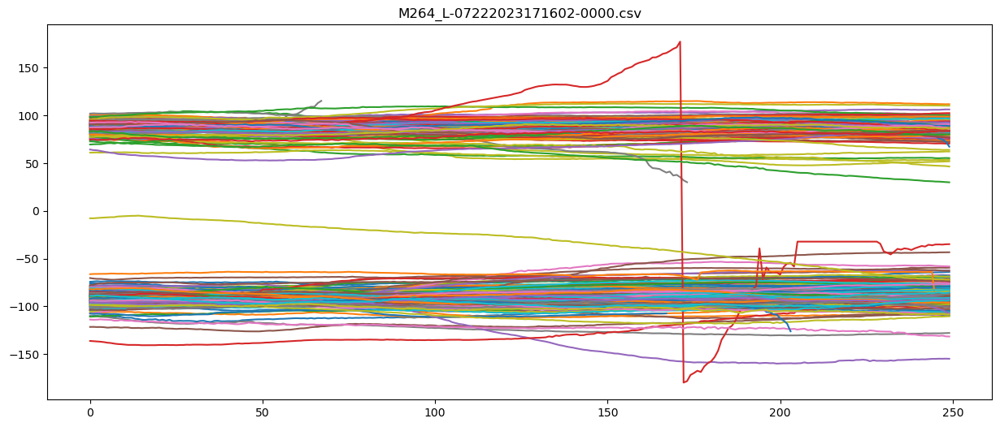

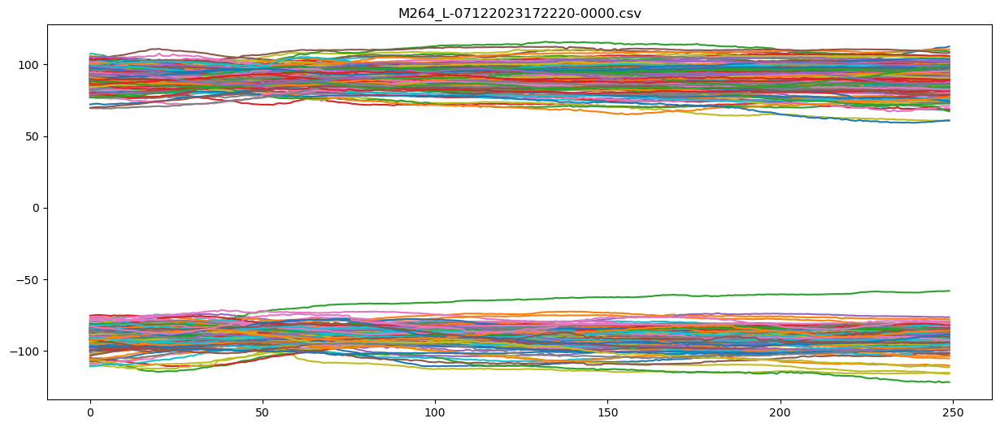

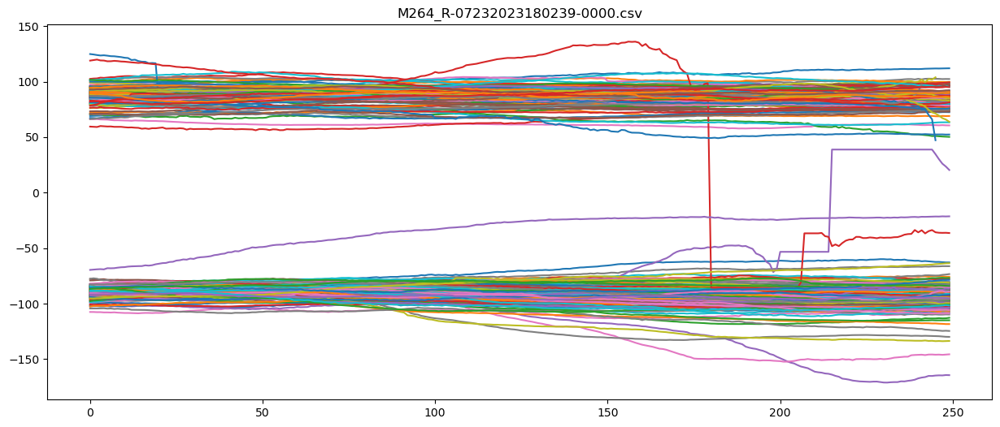

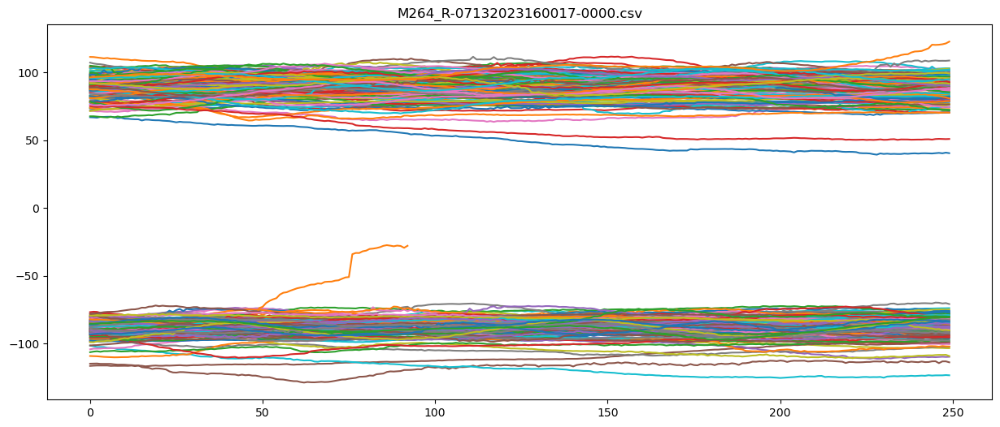

In [96]:
#Write script to pre-process and organize all pert trial into python dict for dict with seperate widths

# search_key = ['L_4mm_12July2023', 'R_4mm_13July2023', 'L_4mm_27July2023', 'R_4mm_28July2023', \
#               'L_10mm_24July2023', 'R_10mm_25July2023', 'L_45mm_22July2023', 'R_45mm_23July2023']
search_key = folders_with_suffix


dict_percswings_widths = defaultdict(dict)

for i in np.arange(len(search_key)):
    dict_ridge = dict_ridge_widths[search_key[i]]
    dict_ridge = assign_dict_value_LEDPeak(dict_ridge)
    dict_ridge = assign_dict_value_TA_and_Ridge_chunkPSTH(dict_ridge)
    dict_ridge = delete_outliers(dict_ridge, outliers_key)
    dict_percswings_widths[search_key[i]] = dict_ridge

In [98]:
def return_Mean_STD_forPSTH(array_value_dict):
    mean_array = np.nanmean(array_value_dict, axis = 0)
    STD_array = stats.sem(array_value_dict, nan_policy='omit')
    return mean_array, STD_array

In [100]:
def adjust_array_360(arr, index, threshold_neg, threshold_pos):
    if len(arr)>200:
        if arr[index] < threshold_neg:
            arr = [value + 360 for value in arr]
        if arr[index] > threshold_pos:
            arr = [value - 360 for value in arr]
    else:
        print('some elements missing in tail array')
    return arr

In [102]:
###############Figure 4C

In [104]:
# DECIDE HERE INTERVAL TO PLOT
int_beg = 0
int_end = 500

In [106]:
def flip_if_mostly_negative(time_series):
    # Convert the input to a numpy array for easier manipulation
    time_series = np.array(time_series)
    
    # Calculate the proportion of negative values
    negative_proportion = np.sum(time_series < 0) / len(time_series)
    
    # If the majority of values are negative, flip the series
    if negative_proportion > 0.5:
        time_series = 180-abs(time_series)
    else:
        time_series = time_series
    
    return time_series

In [228]:
def plot_and_append_AngMomTraces(dict_ridge_Xwidth, color_list):
    fig, ax1 = plt.subplots(1, 1, figsize=(15,6))
#     HA_traj_list = []
    value_traj_list = []
#     HA_traj_list_AngMom = []
#     TA_traj_list_AngMom = []
#     Ridge_traj_list = []
#     TA_cum_angmom_list = []
    Pre_Post_BoS_list = []
    clrs = sns.color_palette("viridis", n_colors=8)   
    values_filename_list = list(dict_ridge_Xwidth.values())
    key_filename_list = list(dict_ridge_Xwidth.keys())
    for i in np.arange(len(key_filename_list)):
#             RidgePert_classvalue = values_filename_list[i][-8]
#             HA_traj = values_filename_list[i][-1][4]
        BoS_traj = values_filename_list[i][-1][0]
        LED_traj = values_filename_list[i][-1][1]
        CentX_traj = values_filename_list[i][-1][3]
        CentY_traj = values_filename_list[i][-1][4]
        BodyAxis_traj = values_filename_list[i][-1][5]
        BodyAxis_traj_flipped = flip_if_mostly_negative(BodyAxis_traj)

        if any(BoS_traj) and len(BoS_traj)==250:# and np.nanmean(TA_traj[30:50])>0 and all(TA_traj>-100) and all(TA_traj<420):# and all(TA_traj>100):
            plt.title("{i}".format(i=key_filename_list[i]))
            ################################################
            #Decide here what to plot
            value_to_append = smooth((BoS_traj-BoS_traj[50]), 10)#BoS_traj-BoS_traj[50]#smooth((BoS_traj-BoS_traj[50]), 5)
#             value_to_append = np.diff(smooth(-CentY_traj, 5))
#             value_to_append = BodyAxis_traj_flipped-BodyAxis_traj_flipped[50]
#             value_to_append = CentX_traj-CentX_traj[50]

            ################################################
            stats_to_print = np.nanmean(value_to_append[30:50])#np.nanmean(value_to_append[100:150])#np.nanmean(value_to_append[0:50])#np.nanmean(value_to_append[50:200])
            Pre_Post_BoS_list.append(stats_to_print)
            value_traj_list.append(value_to_append)
            ax1.plot(value_to_append)
            ax1.plot(LED_traj/50, 'b')
            

#         else:
#             print('not enough elements in array')
        

    print(np.nanmean(Pre_Post_BoS_list))#, len(Pre_Post_BoS_list), key_filename_list[i])
                        
    return value_traj_list#, HA_traj_list, Ridge_traj_list, TA_traj_list_AngMom, HA_traj_list_AngMom, TA_HA_comb_list

In [231]:
def plot_PSTH_Mean_STD_label_color_pre_assigned(mean_array, std_array, ax, lineopacity, clrs, label_strings):
    with sns.axes_style("darkgrid"):
        for i in range(len(mean_array)):
            epochs = list(range(len(mean_array[i])))
            mean_array[i] = mean_array[i][int_beg:int_end]#-mean_array[i][100]
            x = np.linspace(0, (beg_inter_PSTH+end_inter_PSTH), len(mean_array[i]))
            ax1.plot(x, mean_array[i], c=clrs, alpha=lineopacity)
            ax1.fill_between(x, mean_array[i]-std_array[i][int_beg:int_end], mean_array[i]+std_array[i][int_beg:int_end], \
                            alpha=0.2, facecolor=clrs, label = label_strings)
#             ax1.legend(loc="upper right", fontsize = 13, frameon=False)
            ax1.set_xlabel('Frame number (FR = 300 Hz)')
            ax1.set_ylabel('Angular Momentum (g-cm2/s)')
#             ax.axvline(57/0.3,0,360, color = 'red')
#             ax.axvline(73/0.3,0,360, color = 'red')
#             ax.axvline(85/0.3,0,360, color = 'red')

    return ax

In [233]:
def compute_AngMom_width(TA_traj_list):
    mean_TA, std_TA = return_Mean_STD_forPSTH(TA_traj_list)
    means = [mean_TA]
    stds = [std_TA]
    return means, stds

In [235]:
# sal_dict = dict_percswings_widths['SAL']
# print(list(sal_dict.keys()))

In [237]:
search_key

['ORE_M251-64_StimON_L_45mm_22July2023',
 'ORE_M251-64_StimON_L_4mm_12July2023',
 'ORE_M251-64_StimON_R_45mm_23July2023',
 'ORE_M251-64_StimON_R_4mm_13July2023']

C:\Users\salva\AppData\Local\Temp\ipykernel_113828\2568747276.py:6: RuntimeWarning: invalid value encountered in scalar divide
  negative_proportion = np.sum(time_series < 0) / len(time_series)


-61.42246784216099
-1.2769995448533968
9.617525668988764
7.20280311216374
-67.89805584086311
-11.069178944804504
-5.539494965504522
0.16954372621520467
15.320694682029202
16.744413748023405
-4.313592994397559
-1.922329586909375
22.180189111462116
6.843903710974067
-9.4126122213377
-16.826003277517042
-18.723987533959342
-5.2131213549807045
-17.649672241061708
-13.861833709117203
-45.26343617317414
16.384422095134305
4.416845451017404


C:\Users\salva\AppData\Local\Temp\ipykernel_113828\3970337853.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax1 = plt.subplots(1, 1, figsize=(15,6))


-21.28788539380548
10.040329161621075
-9.589807888261976
18.553858161316306
-2.6070836001208977


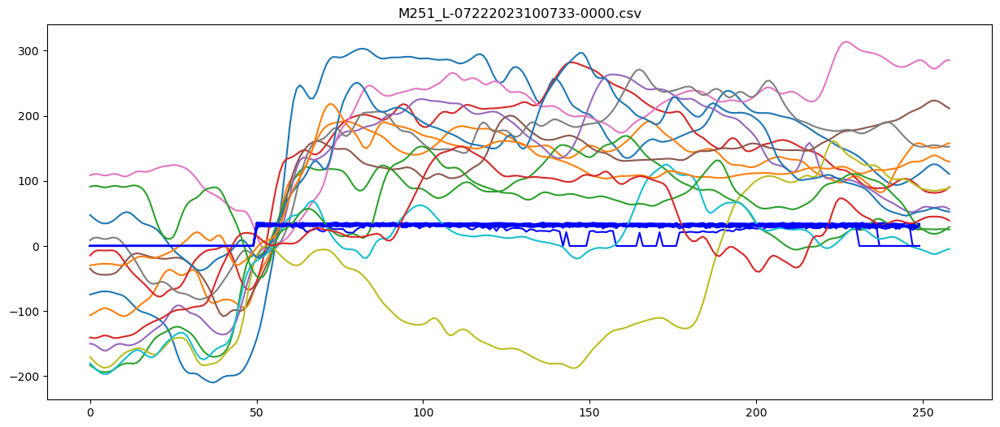

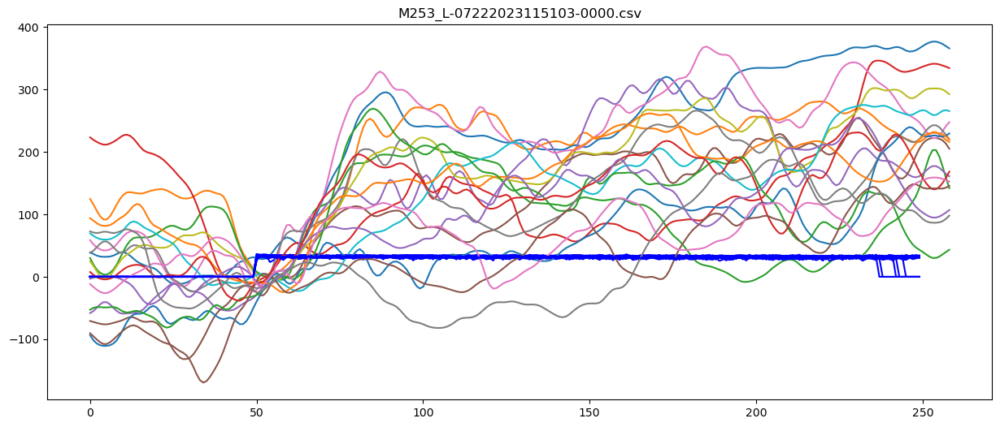

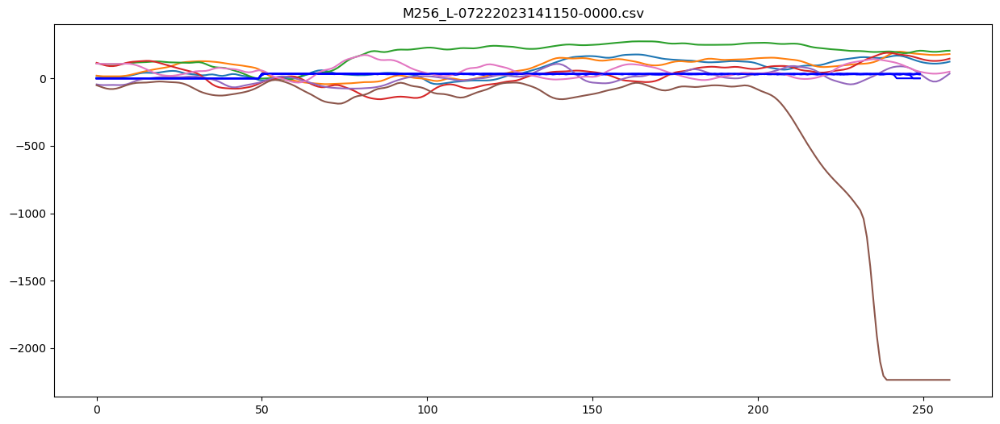

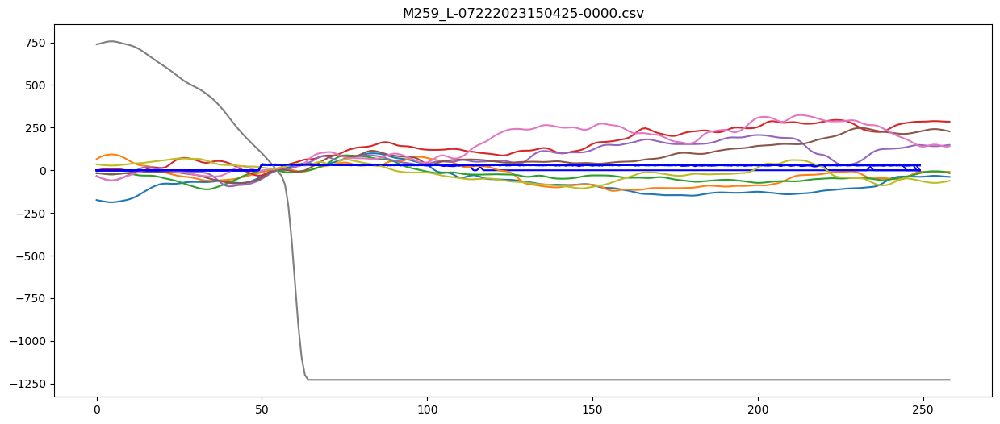

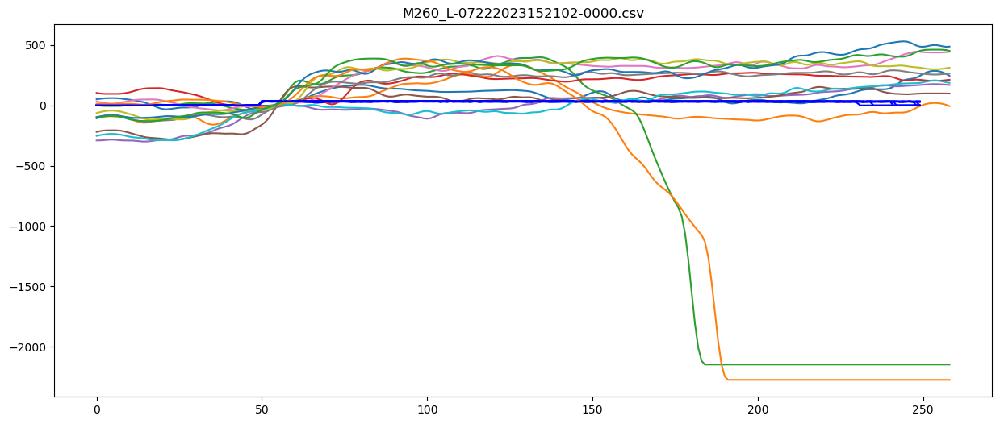

...

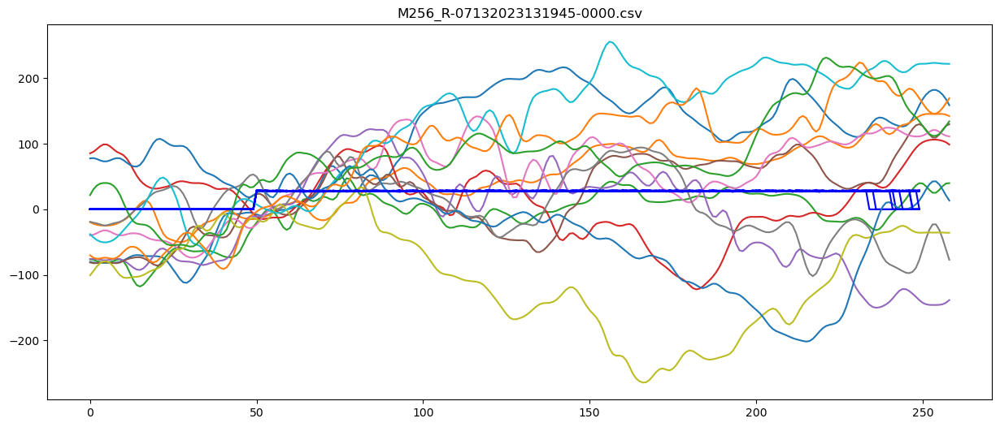

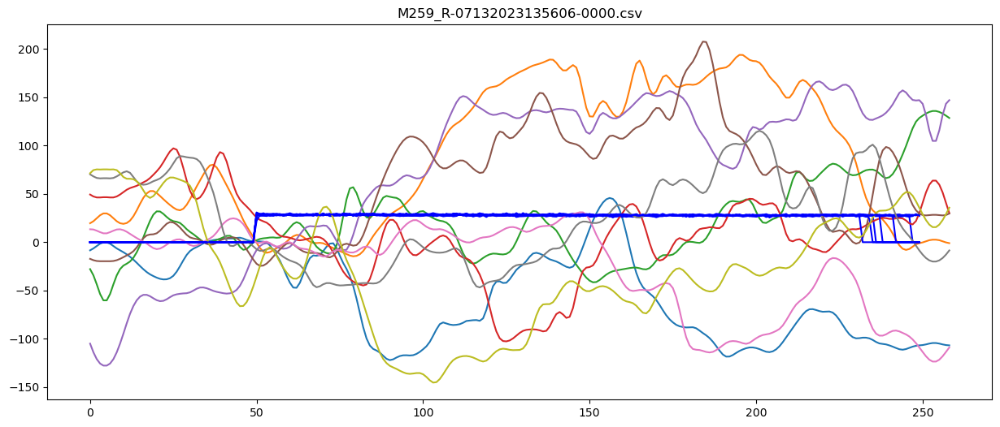

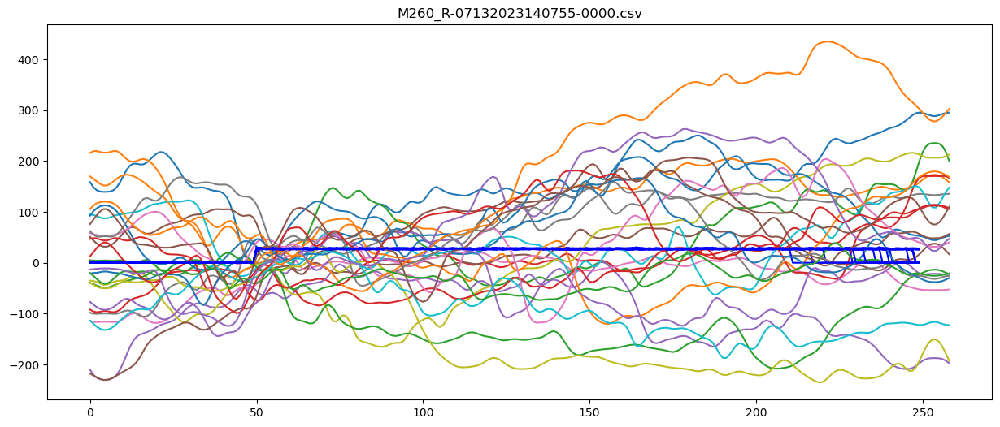

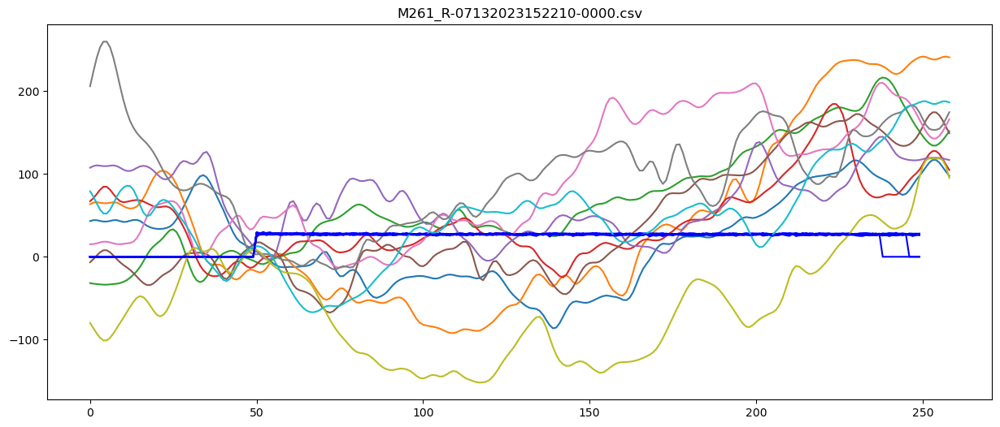

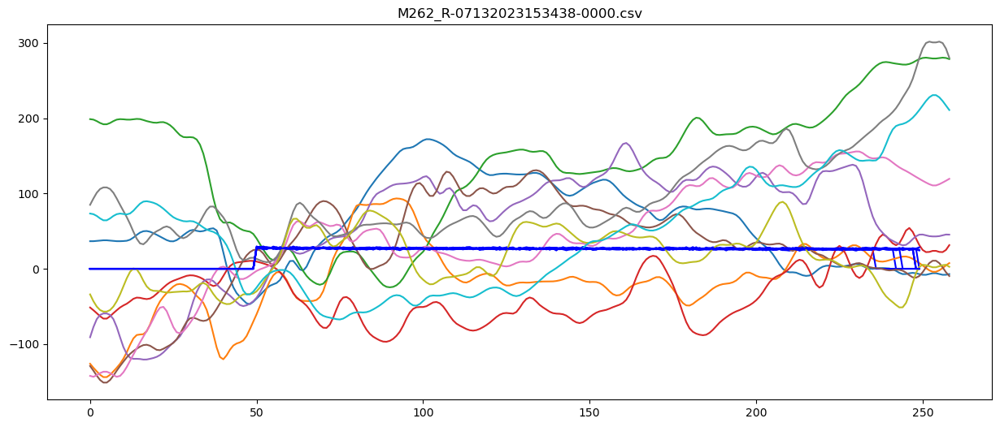

In [239]:
#Plot trials of same width together changing the dict_ridge_all key

# Xwidth_keys = ['ORE_M251-64_StimON_L_4mm_12July2023', 'ORE_M251-64_StimON_L_45mm_22July2023']#'R_4mm_13July2023', 'L_4mm_27July2023', 'R_4mm_28July2023', \
Xwidth_keys = search_key

#M255 only left side I think
MouseID_key = ['M251', 'M253', 'M256', 'M259', 'M260', 'M261', 'M262']
# angmom_lowerinterv = [100, 100, 100, 100, 105, 105, 105]
# angmom_higherinterv = [150, 150, 150, 150, 150, 150]
clrs = sns.color_palette("husl", len(Xwidth_keys))
#fig, ax1 = plt.subplots(1, 1, figsize=(15,6))

list_std_AngMom = []
list_TAtraj_means = []
list_TAtraj_stds = []
dict_TAmeansStds_byMouseID_Cond = defaultdict(dict)

for i in np.arange(len(Xwidth_keys)):
    list_TAtraj = []
    list_TAtraj_stds = []
    dict_ridge_Xwidth = dict_percswings_widths[Xwidth_keys[i]]
    for m in np.arange(len(MouseID_key)):
        dict_ridge_XwidthXmouseID = dict(filter(lambda item: MouseID_key[m] in item[0], dict_ridge_Xwidth.items()))
        #Decide here what to plot (TA/BoS/ComY)
        TA_traj_list = plot_and_append_AngMomTraces(dict_ridge_XwidthXmouseID, clrs[i])  # Use clrs[i] to select color dynamically
        #compute means+stds
#         print(len(TA_traj_list))
        means, stds = compute_AngMom_width(TA_traj_list)
        list_TAtraj.append(means)
        list_TAtraj_stds.append(stds)
        dict_TAmeansStds_byMouseID_Cond[MouseID_key[m]][Xwidth_keys[i]] = [means, stds]
#         plt.ylim(-300, 300)
        



In [242]:
#returr neg values
def neg(lst):
    return [x for x in lst if x < 0] or None

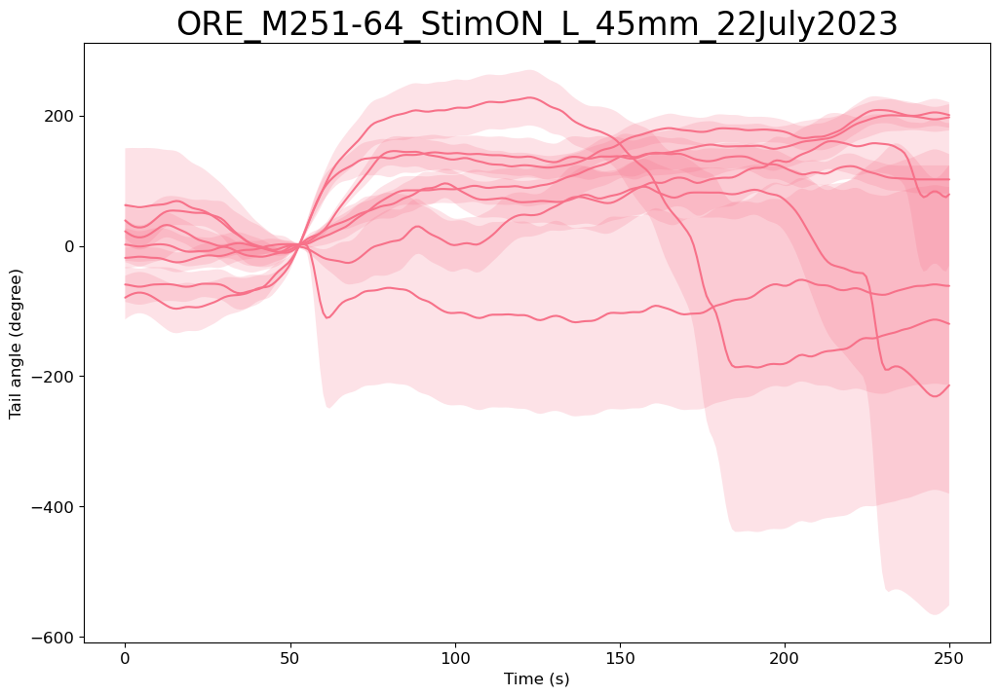

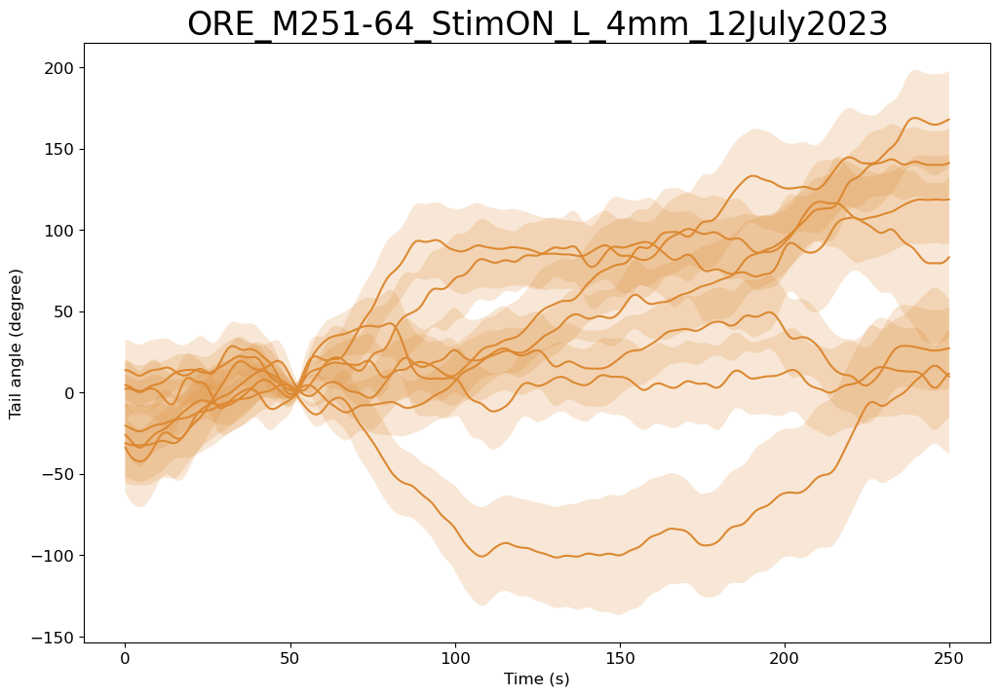

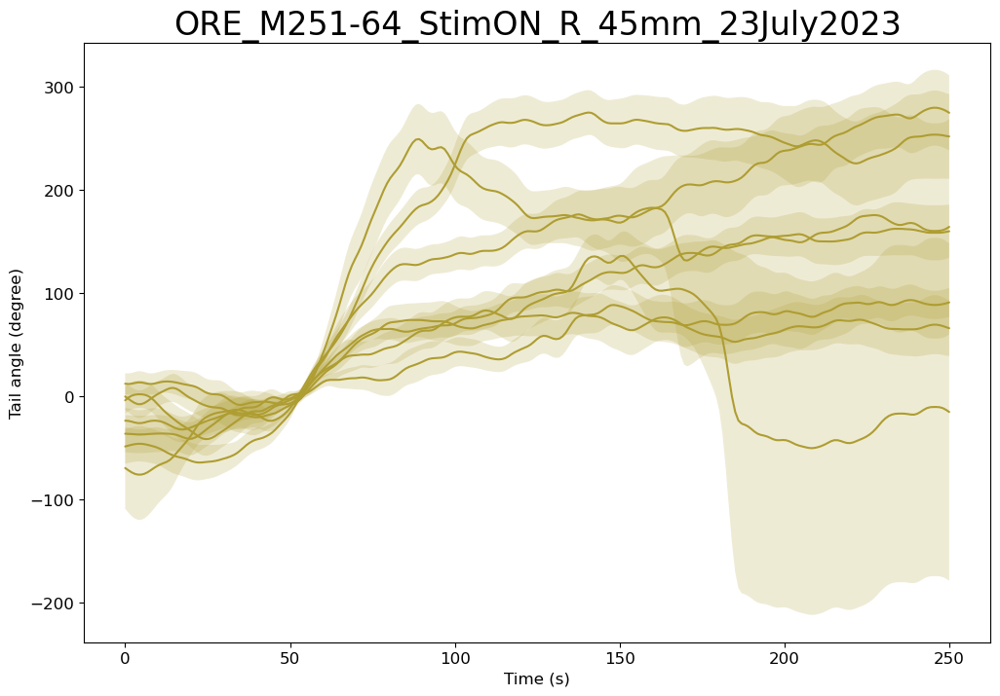

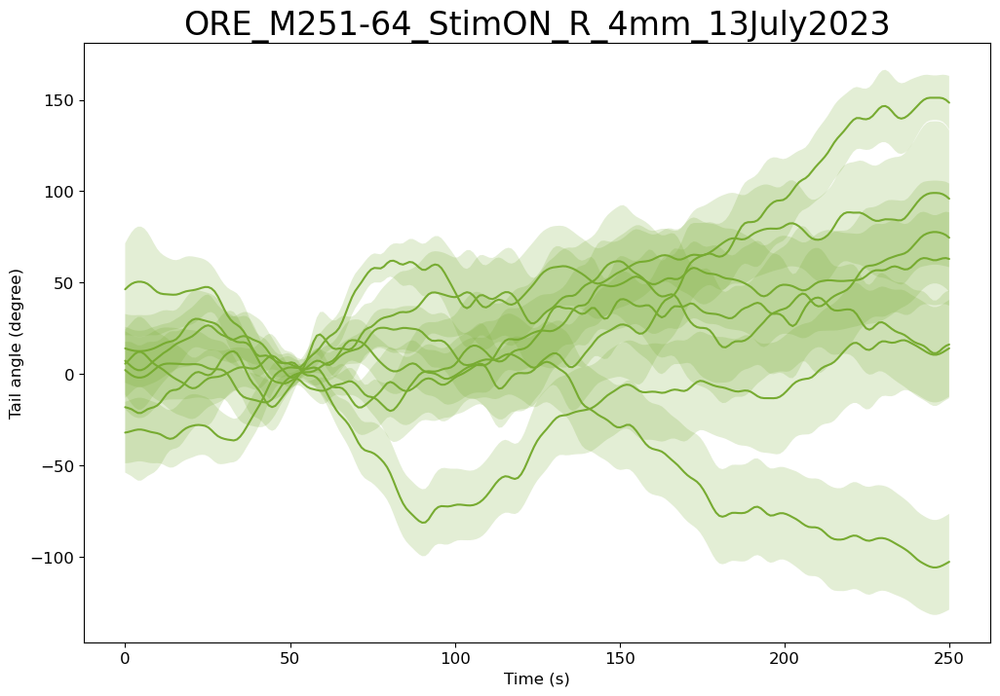

In [244]:
clrs = sns.color_palette("husl", 10)
label_strings = Xwidth_keys
lineopacity = [1] * 10



for j in np.arange(len(Xwidth_keys)):
    fig, ax1 = plt.subplots(figsize=(12, 8))
    for i in np.arange(len(MouseID_key)):
#         fig, ax1 = plt.subplots(figsize=(12, 8))
        plot_PSTH_Mean_STD_label_color_pre_assigned(dict_TAmeansStds_byMouseID_Cond[MouseID_key[i]][Xwidth_keys[j]][0], \
                                                    dict_TAmeansStds_byMouseID_Cond[MouseID_key[i]][Xwidth_keys[j]][1], \
                                                    ax1, lineopacity[j], clrs[j], label_strings[j])
    
#         plt.ylim(-150, 150)
#         ax1.legend(loc="lower left", prop={'size': 12})
        ax1.set_xlabel('Time (s)', fontsize=12)
        ax1.set_ylabel('Tail angle (degree)', fontsize=12)
        ax1.tick_params(axis='both', which='major', labelsize=12) 
        ax1.set_title("{i}".format(i = Xwidth_keys[j]),  fontsize=24)
        fig.savefig('nopertTA_allMiceallWidth_{}.svg'.format(Xwidth_keys[j]), format='svg', dpi=1200)
#         plt.close(fig)  # Close the figure to release memory

In [53]:
# for arr in TA_traj_list:
#     print(len(arr))

In [54]:
########  plot mean of trials per mouse as single line, and average across all mice in single session with sem


In [252]:
def plot_PSTH_Mean_STD_label_color_pre_assigned(mean_array, std_array, ax, lineopacity, clrs, label_strings):
    with sns.axes_style("darkgrid"):
        for i in range(len(mean_array)):
            mean_array[i] = mean_array[i][int_beg:int_end]#-mean_array[i][100]
            x = np.linspace(0, (beg_inter_PSTH+end_inter_PSTH), len(mean_array[i][0]))
            ax1.plot(x, mean_array[i][0], c=clrs, alpha=0.5, lw = 0.7)
#             ax1.fill_between(x, mean_array[i][0]-std_array[i][0][int_beg:int_end], mean_array[i][0]+std_array[i][0][int_beg:int_end], \
#                             alpha=0.2, facecolor=clrs, label = label_strings)
#             ax1.legend(loc="upper right", fontsize = 13, frameon=False)
            ax1.set_xlabel('Frame number (FR = 300 Hz)')
            ax1.set_ylabel('Angular Momentum (g-cm2/s)')
            
        # Calculate the mean and standard deviation across all arrays for each time step
        all_arrays_stacked = np.stack(mean_array)
        mean_across_arrays = np.mean(all_arrays_stacked, axis=0)
        std_across_arrays = stats.sem(all_arrays_stacked, axis=0)
        
        ax.plot(x, mean_across_arrays[0], c=clrs, linewidth=3, label='Mean Across Arrays')
        ax.fill_between(x, mean_across_arrays[0] - std_across_arrays[0], mean_across_arrays[0] + std_across_arrays[0], \
                        alpha=0.5, facecolor=clrs, label='Mean ± Std Across Arrays')

    return ax

In [254]:
search_key

['ORE_M251-64_StimON_L_45mm_22July2023',
 'ORE_M251-64_StimON_L_4mm_12July2023',
 'ORE_M251-64_StimON_R_45mm_23July2023',
 'ORE_M251-64_StimON_R_4mm_13July2023']

C:\Users\salva\AppData\Local\Temp\ipykernel_113828\2568747276.py:6: RuntimeWarning: invalid value encountered in scalar divide
  negative_proportion = np.sum(time_series < 0) / len(time_series)


0.16954372621520467
15.320694682029202
-4.313592994397559
-1.922329586909375
22.180189111462116
6.843903710974067
-61.42246784216099
-1.2769995448533968
7.20280311216374
-67.89805584086311
-11.069178944804504
-5.539494965504522
16.384422095134305
4.416845451017404
10.040329161621075
-9.589807888261976
18.553858161316306
-2.6070836001208977
-9.4126122213377
-16.826003277517042


C:\Users\salva\AppData\Local\Temp\ipykernel_113828\3970337853.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax1 = plt.subplots(1, 1, figsize=(15,6))


-5.2131213549807045
-17.649672241061708
-13.861833709117203
-45.26343617317414


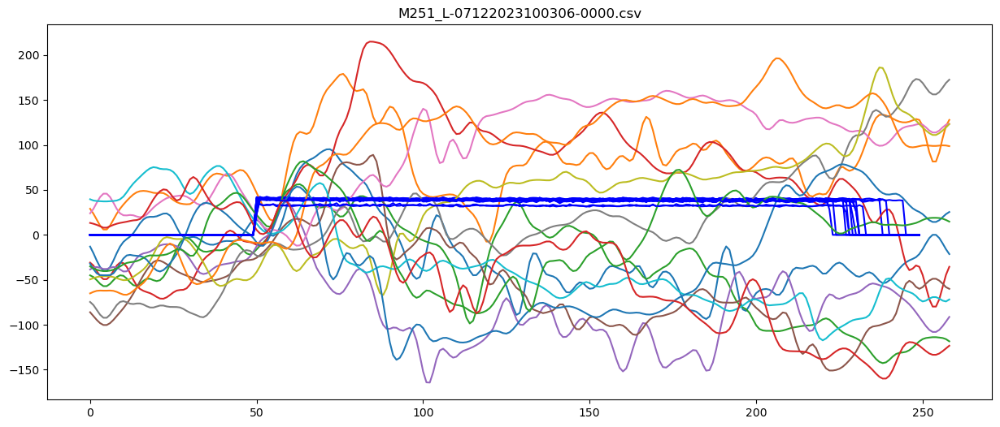

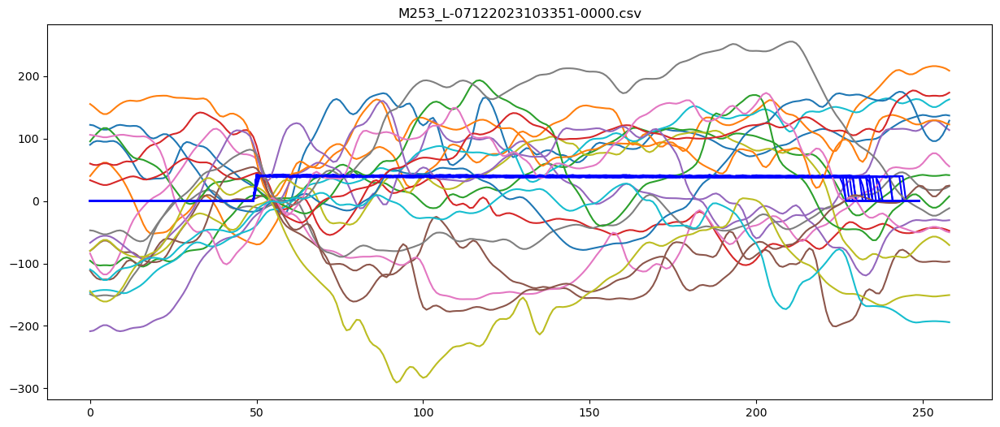

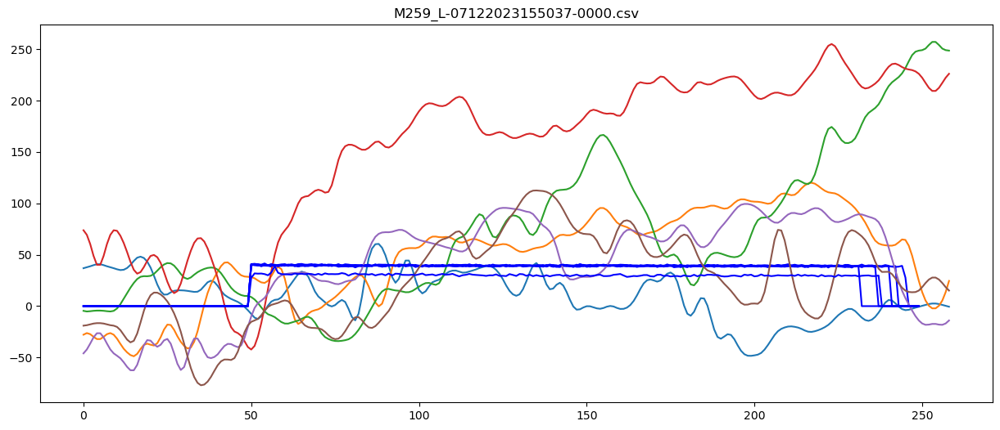

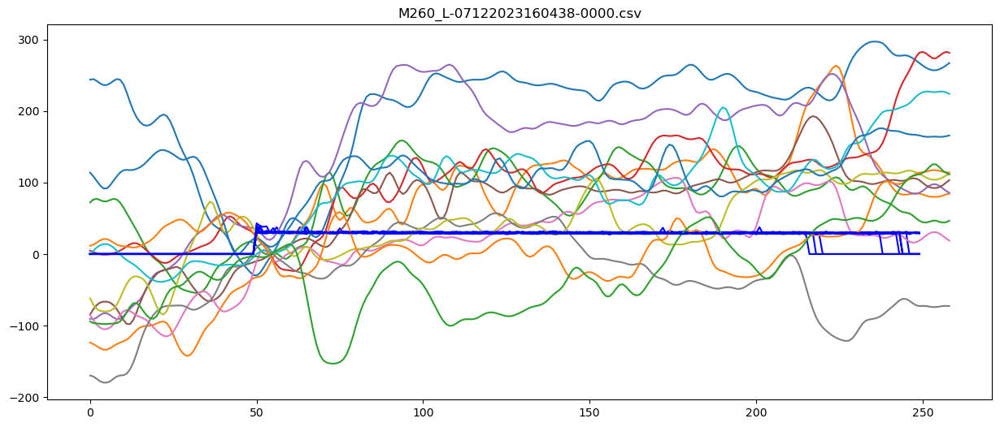

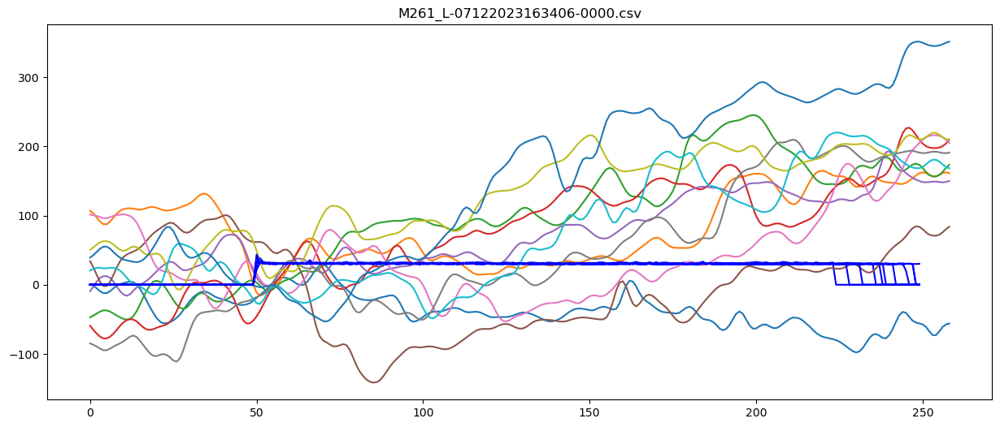

...

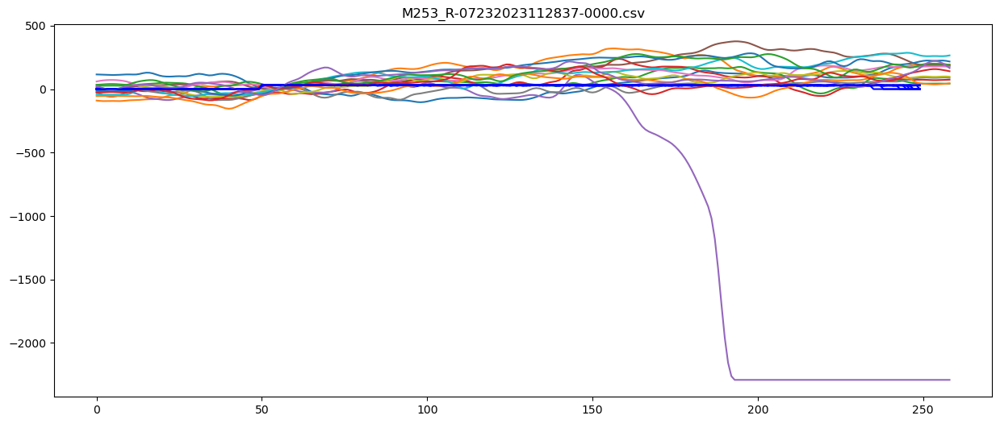

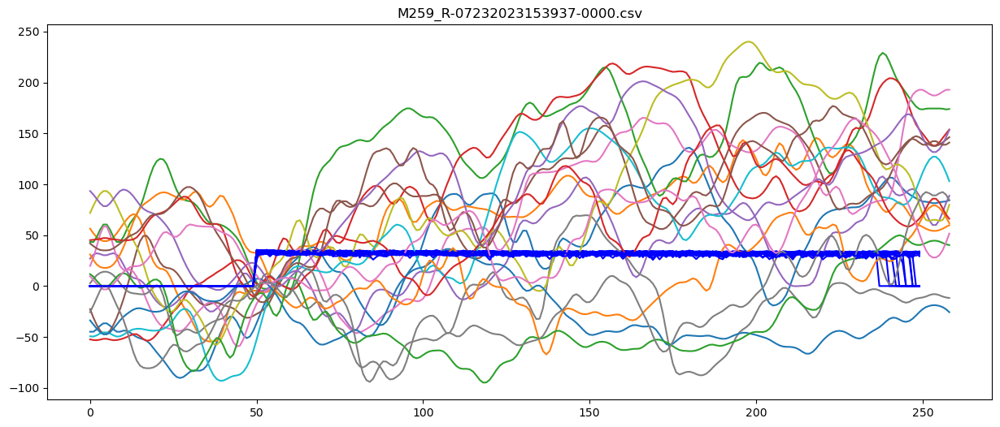

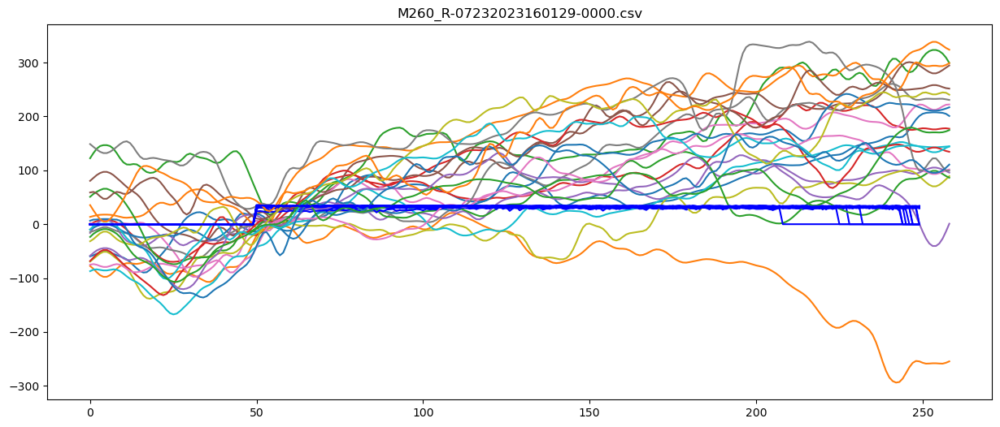

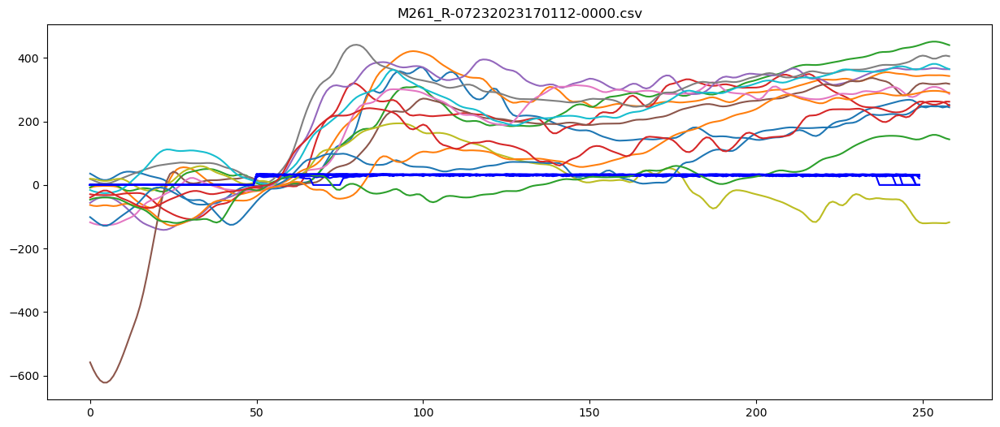

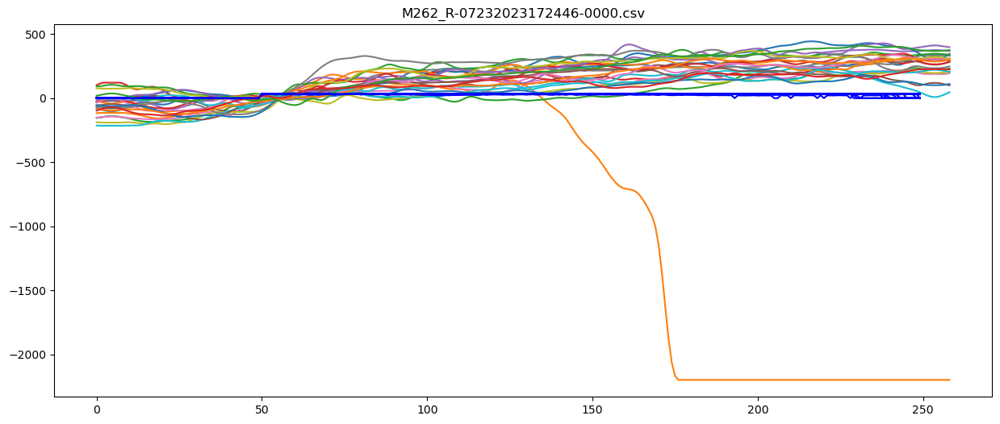

In [268]:
#Plot trials of same width together changing the dict_ridge_all key

Xwidth_keys = ['ORE_M251-64_StimON_L_4mm_12July2023', 'ORE_M251-64_StimON_L_45mm_22July2023', \
               'ORE_M251-64_StimON_R_4mm_13July2023', 'ORE_M251-64_StimON_R_45mm_23July2023']#, 'ORE_M251-64_StimON_L_4mm_27July2023']#'R_4mm_13July2023', 'L_4mm_27July2023', 'R_4mm_28July2023', \
# Xwidth_keys = search_key

#M255 only left side I think
#['M251', 'M252', 'M253', 'M254', 'M255', 'M256', 'M257', 'M258', 'M259', 'M260', 'M261', 'M262', 'M263', 'M264']
# # Left 4mm
# MouseID_key = ['M251', 'M259', 'M260', 'M261', 'M262']
# Right 4mm
MouseID_key = ['M251', 'M253', 'M259', 'M260', 'M261', 'M262']

clrs = sns.color_palette("husl", len(Xwidth_keys))
#fig, ax1 = plt.subplots(1, 1, figsize=(15,6))

list_std_AngMom = []
list_TAtraj_means = []
list_TAtraj_stds = []
dict_TAmeansStds_byMouseID_Cond = defaultdict(dict)

for i in np.arange(len(Xwidth_keys)):
    list_TAtraj = []
    list_TAtraj_stds = []
    dict_ridge_Xwidth = dict_percswings_widths[Xwidth_keys[i]]
    for m in np.arange(len(MouseID_key)):
        dict_ridge_XwidthXmouseID = dict(filter(lambda item: MouseID_key[m] in item[0], dict_ridge_Xwidth.items()))
        TA_traj_list = plot_and_append_AngMomTraces(dict_ridge_XwidthXmouseID, clrs[i])
        #compute means+stds
#         print(len(TA_traj_list))
        means, stds = compute_AngMom_width(TA_traj_list)
        list_TAtraj.append(means)
        list_TAtraj_stds.append(stds)
        dict_TAmeansStds_byMouseID_Cond[Xwidth_keys[i]] = [list_TAtraj, list_TAtraj_stds]
#         plt.ylim(-100, 250)
        



In [269]:
# dict_TAmeansStds_byMouseID_Cond['R_4mm_28July2023']

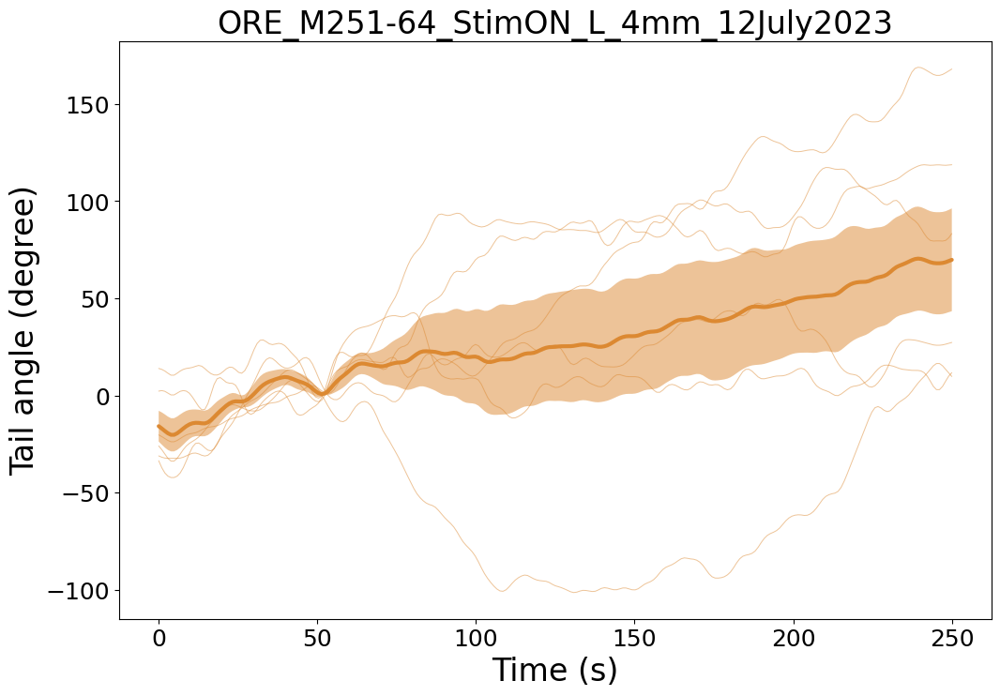

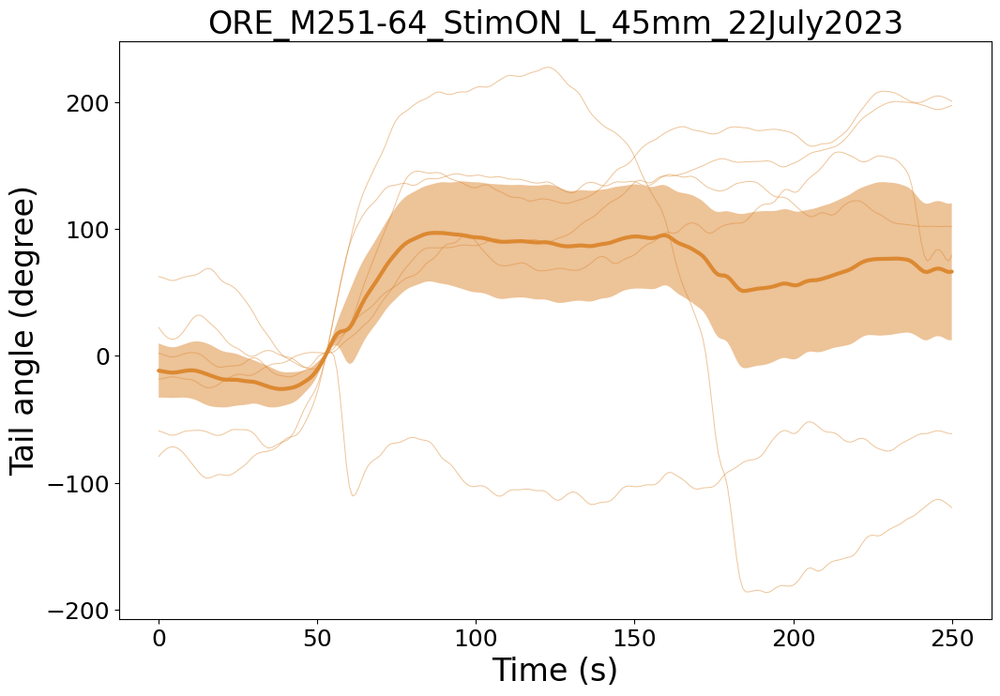

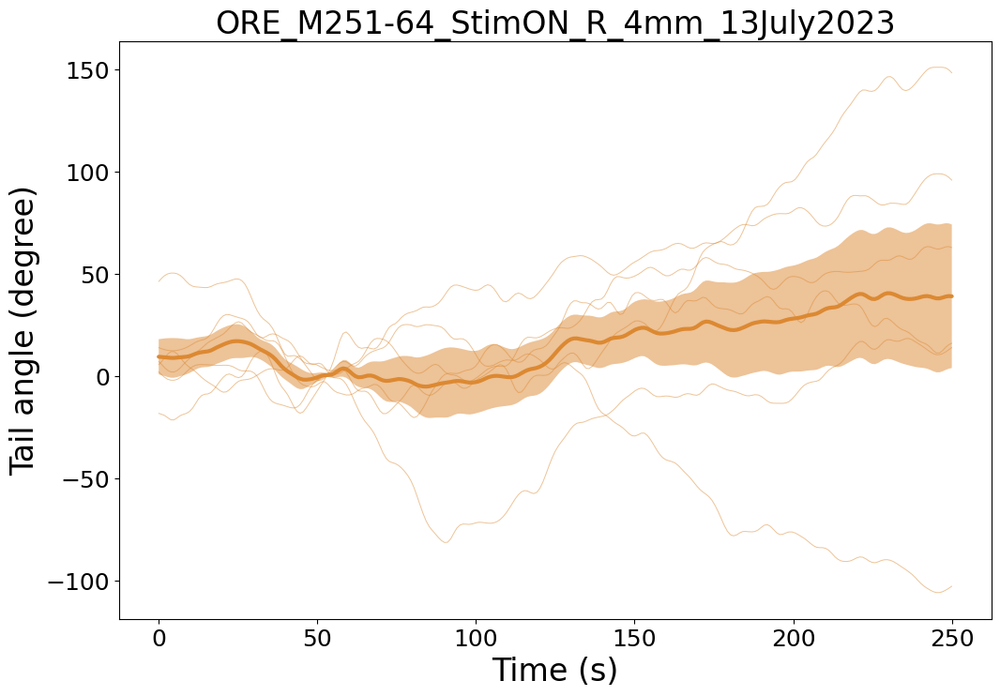

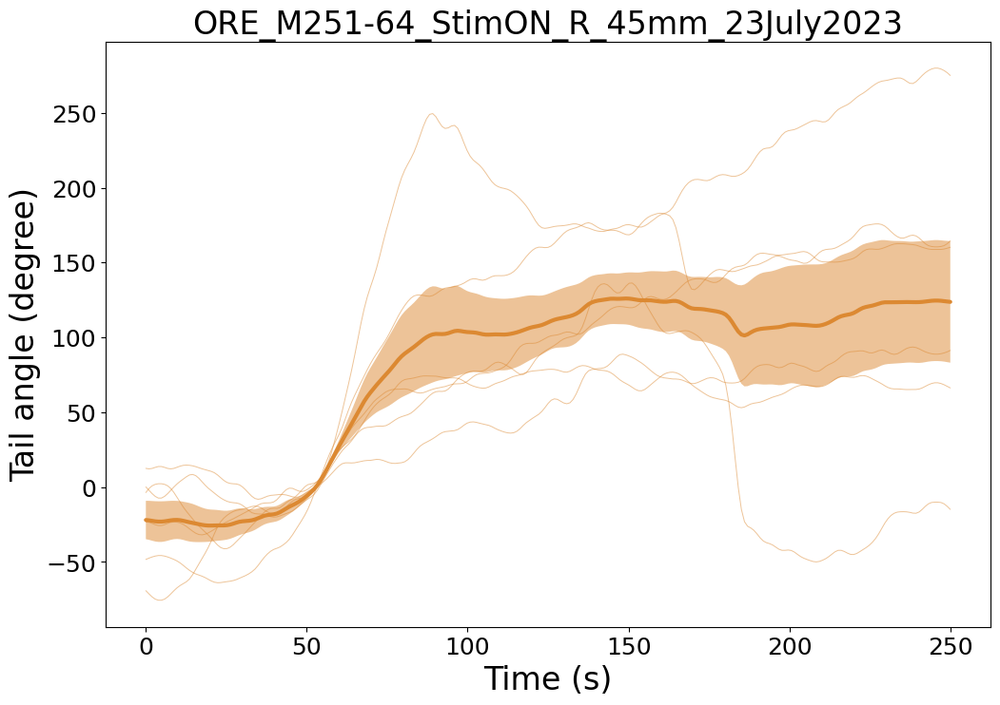

In [270]:
clrs = sns.color_palette("husl", 10)
label_strings = Xwidth_keys
lineopacity = [1] * 10

# fig, ax1 = plt.subplots(figsize=(12, 12))


for j in np.arange(len(Xwidth_keys)):
        fig, ax1 = plt.subplots(figsize=(12, 8))

        plot_PSTH_Mean_STD_label_color_pre_assigned(dict_TAmeansStds_byMouseID_Cond[Xwidth_keys[j]][0], \
                                                    dict_TAmeansStds_byMouseID_Cond[Xwidth_keys[j]][1], \
                                                    ax1, lineopacity[j], clrs[1], label_strings[j])
#         plt.ylim(-10, 10)
#         plt.xlim(20, 230)

#         ax1.legend(loc="lower left", prop={'size': 12})
        ax1.set_xlabel('Time (s)', fontsize=24)
        ax1.set_ylabel('Tail angle (degree)', fontsize=24)
        ax1.tick_params(axis='both', which='major', labelsize=18) 
        ax1.set_title("{i}".format(i = Xwidth_keys[j]),  fontsize=24)
        fig.savefig('nopertTA_allMiceallWidth_{}.svg'.format(Xwidth_keys[j]), format='svg', dpi=1200)


In [60]:
####################Plot COMY velocity during perturbation for 10-20-30 deg tilts